# <div style="padding: 30px; color:white; margin:10; font-size:95%; text-align:left; display:fill; border-radius:10px; background-color:#3b3745"><b> Intel Review - Exploratory Data Analysis - Pre-Sentiment Analysis</b></div>

<div style="background-color: #3b3745; border-radius: 12px; padding: 20px; box-shadow: 0 4px 8px 0 rgba(0,0,0,0.2);">
    <h2 style="color: #F1A424; text-align: center;">Table of Contents</h2>
    <ul style="list-style: none; padding: 0;">
        <li><a href="#section-1" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">1.</span>  Importing Libraries</a></li>
        <li><a href="#section-2" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">2.1</span>Loading the CSV file in dataframe and analysing the data</a></li>
        <li><a href="#section-3" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">2.2</span>  Dropping rows with missing values present from dataset </a></li>
        <li><a href="#section-4" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">2.3</span> Inserting columns 'Generation' & 'Length' and changing Date format</a></li>
        <li><a href="#section-5" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">3.</span> Segmentation Analysis based on Intel Processor types, generations and models</a></li>
        <li><a href="#section-6" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">4.</span>  Analyzing 'Generation' column</a></li>
        <li><a href="#section-7" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">5.</span> Analyzing 'Source' column</a></li>
        <li><a href="#section-8" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">6.</span>  Analyzing 'Rating' column</a></li>
        <li><a href="#section-9" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">7.</span>  Analyzing 'Product' column</a></li>
        <li><a href="#section-10" style="color: white; text-decoration: none; display: flex; align-items: center; padding: 8px 15px; border-radius: 6px; transition: background-color 0.3s;"><span style="margin-right: 10px; font-weight: bold; color: #F1A424;">8.</span>  Analyzing 'Review' column</a></li>
    </ul>
</div>

<a id="section-1"></a>
# <div style="padding: 30px; color:white; margin:10; font-size:75%; text-align:left; display:fill; border-radius:10px; background-color:#3b3745"><b><span style='color:#F1A424'>1 |</span></b> <b>  Importing Libraries</b></div>

In [4]:
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from sklearn.feature_extraction.text import CountVectorizer
import nltk
from nltk.stem.porter import PorterStemmer
nltk.download('stopwords')
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))
from wordcloud import WordCloud


[nltk_data] Downloading package stopwords to /Users/jyo/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [5]:
%pip install wordcloud

Note: you may need to restart the kernel to use updated packages.



 <a id="section-2"></a>
# <div style="padding: 30px; color:white; margin:10; font-size:75%; text-align:left; display:fill; border-radius:10px; background-color:#3b3745"><b><span style='color:#F1A424'> 2.1 |</span></b> <b>Loading the CSV file in dataframe and analysing the data
</b></div>


In [122]:
data = pd.read_csv("../data/2-dataset_7.csv")

print(f"Dataset shape : {data.shape}")

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.
Dataset shape : (7530, 5)


In [32]:
data.head(4)

,Product,Rating,Date,Source,Review
0,intel-i7-14700k,5.0,November/2023,amazon,far good cpu monster run very nicely boost max...
1,intel-i7-14700k,5.0,January/2024,amazon,guess everyone right thing hot went brand aio ...
2,intel-i7-14700k,5.0,March/2024,amazon,intel ik delivers impressive performance high ...
3,intel-i7-14700k,5.0,May/2024,amazon,purchase cpu please also purchase alongside pu...


In [33]:
print(f"Feature names : {data.columns.values}")

Feature names : ['Product' 'Rating' 'Date' 'Source' 'Review']


Calculating the sum of missing values for each feature in the dataset

 <a id="section-3"></a>
# <div style="padding: 30px; color:white; margin:10; font-size:75%; text-align:left; display:fill; border-radius:10px; background-color:#3b3745"><b><span style='color:#F1A424'> 2.2 |</span></b> <b>  Dropping rows with missing values present from dataset 
</b></div>

In [34]:
data.isnull().sum()

Product    2
Rating     2
Date       0
Source     2
Review     0
dtype: int64

In [35]:
data[data['Review'].isna() == True]

,Product,Rating,Date,Source,Review


 Dropping rows with missing values from the dataset in place

In [36]:
data.dropna(inplace=True)

In [37]:
data.dropna(subset=['Product'], inplace=True)


In [38]:
print(f"Dataset shape after dropping null values : {data.shape}")

Dataset shape after dropping null values : (7528, 5)


 <a id="section-4"></a>
# <div style="padding: 30px; color:white; margin:10; font-size:75%; text-align:left; display:fill; border-radius:10px; background-color:#3b3745"><b><span style='color:#F1A424'> 2.3 |</span></b> <b>  Inserting columns 'Generation' & 'Length' and changing Date format
</b></div>

In [39]:
data['Length'] = data['Review'].apply(len)

Transforms "Date" to "YYYY-MM" format

In [40]:
data[['Month', 'Year']] = data['Date'].str.split('/', expand=True)

data['Year'] = data['Year'].astype(int)

data['Month'] = pd.to_datetime(data['Month'], format='%B').dt.strftime('%m')

data['Date'] = data['Year'].astype(str) + '-' + data['Month']

data.drop(columns=['Year', 'Month'], inplace=True)


In [41]:
data.head()

,Product,Rating,Date,Source,Review,Length
0,intel-i7-14700k,5.0,2023-11,amazon,far good cpu monster run very nicely boost max...,1317
1,intel-i7-14700k,5.0,2024-01,amazon,guess everyone right thing hot went brand aio ...,752
2,intel-i7-14700k,5.0,2024-03,amazon,intel ik delivers impressive performance high ...,369
3,intel-i7-14700k,5.0,2024-05,amazon,purchase cpu please also purchase alongside pu...,446
4,intel-i7-14700k,5.0,2024-04,amazon,professional cpu isnt designed average user ho...,3310


The 'Length' column is new generated column - stores the length of 'Reviews' for that record. Let's check for some sample records.<br/>
The 'Date' column is changed to the required format.
<br/>
Now, we insert the 'Generation' column

In [43]:
data['Generation'] = data['Product'].str.extract(r'i\d{1,2}-(\d+)', expand=False)

data['Generation'] = data['Generation'].str[:2]
data = data[['Product', 'Generation', 'Rating', 'Date', 'Source', 'Review','Length']]
print(data)


              Product Generation  Rating     Date   Source  \
0     intel-i7-14700k         14     5.0  2023-11   amazon   
1     intel-i7-14700k         14     5.0  2024-01   amazon   
2     intel-i7-14700k         14     5.0  2024-03   amazon   
3     intel-i7-14700k         14     5.0  2024-05   amazon   
4     intel-i7-14700k         14     5.0  2024-04   amazon   
...               ...        ...     ...      ...      ...   
7523  intel-i9-10900k         10     5.0  2023-05  bestbuy   
7524  intel-i9-10900k         10     5.0  2022-07  bestbuy   
7525  intel-i9-10900k         10     5.0  2020-10  bestbuy   
7526  intel-i9-10900k         10     5.0  2020-09  bestbuy   
7527  intel-i9-10900k         10     1.0  2020-08  bestbuy   

                                                 Review  Length  
0     far good cpu monster run very nicely boost max...    1317  
1     guess everyone right thing hot went brand aio ...     752  
2     intel ik delivers impressive performance high ...  

In [44]:
data.head()

,Product,Generation,Rating,Date,Source,Review,Length
0,intel-i7-14700k,14,5.0,2023-11,amazon,far good cpu monster run very nicely boost max...,1317
1,intel-i7-14700k,14,5.0,2024-01,amazon,guess everyone right thing hot went brand aio ...,752
2,intel-i7-14700k,14,5.0,2024-03,amazon,intel ik delivers impressive performance high ...,369
3,intel-i7-14700k,14,5.0,2024-05,amazon,purchase cpu please also purchase alongside pu...,446
4,intel-i7-14700k,14,5.0,2024-04,amazon,professional cpu isnt designed average user ho...,3310


In [45]:
print(f"Dataset shape now : {data.shape}")

Dataset shape now : (7528, 7)


 Randomly checking for an arbitrary record

In [46]:
print(f"'Reviews' column value: {data.iloc[10]['Review']}") 
print(f"Length of review : {len(data.iloc[10]['Review'])}") 
print(f"'length' column value : {data.iloc[10]['Length']}") 

'Reviews' column value: something lot people not understand processor put much voltage going damage want delid dont see need whyeven get degree cooler not matter still need volt stay stable advertised speedsi running ghz p core thing unbelievably reliable maybe second extra render v ghzi get point ppl want bragging right say run fast gwt damaged guaranteed watt lot little unit think enough specially total thread gaming practically single threaded game gpu bound use gaming department flight simulator not seen above degreesi k still running strong ghz very small caseintel beast very good future proof least year come note delided least cpu one got damaged one got lot voltage very heat resistant voltage kill running cpu not issuenot blue screenjust underclock undervolt good go thing monster
Length of review : 773
'length' column value : 773


We can see that the length of review is the same as the value in the length column for that record.

Datatypes of the features

In [47]:
data.dtypes

Product        object
Generation     object
Rating        float64
Date           object
Source         object
Review         object
Length          int64
dtype: object

* Rating, is of float data type <br>
* Product, Date, Source, Generation and are object data type <br>
* Length is of int data type

In [48]:
len(data)

7528

 <a id="section-5"></a>
# <div style="padding: 30px; color:white; margin:10; font-size:75%; text-align:left; display:fill; border-radius:10px; background-color:#3b3745"><b><span style='color:#F1A424'> 3 |</span></b> <b>  Segmentation Analysis based on Intel Processor types, generations and models</b></div>


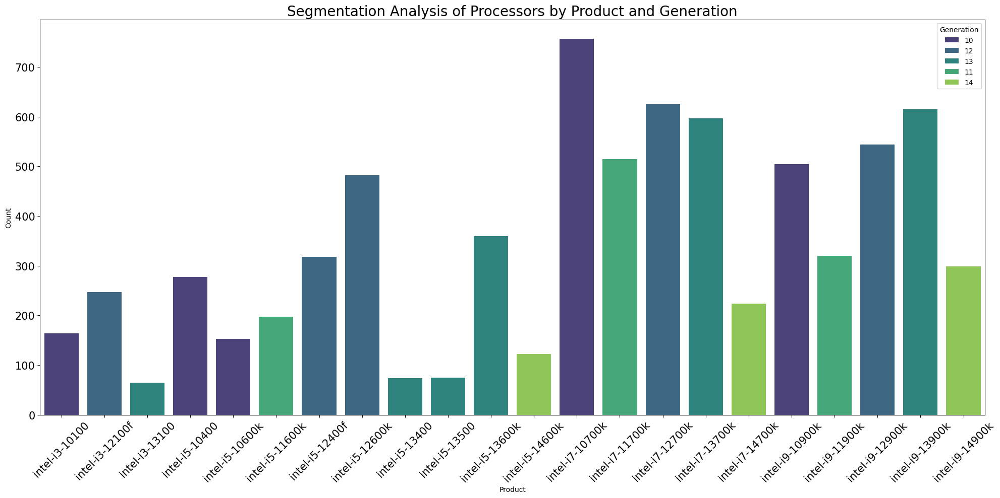

In [50]:
segmentation = data.groupby(['Product', 'Generation']).size().reset_index(name='Count')


# Step 4: Visualize Segmentation
plt.figure(figsize=(20, 10))
sns.barplot(x='Product', y='Count', hue='Generation', data=segmentation, palette='viridis')
plt.title('Segmentation Analysis of Processors by Product and Generation', fontsize=20)
plt.xlabel('Product')
plt.ylabel('Count')
plt.yticks(fontsize=15)
plt.xticks(rotation=45, fontsize=15)
plt.legend(title='Generation')
plt.tight_layout()
plt.show()

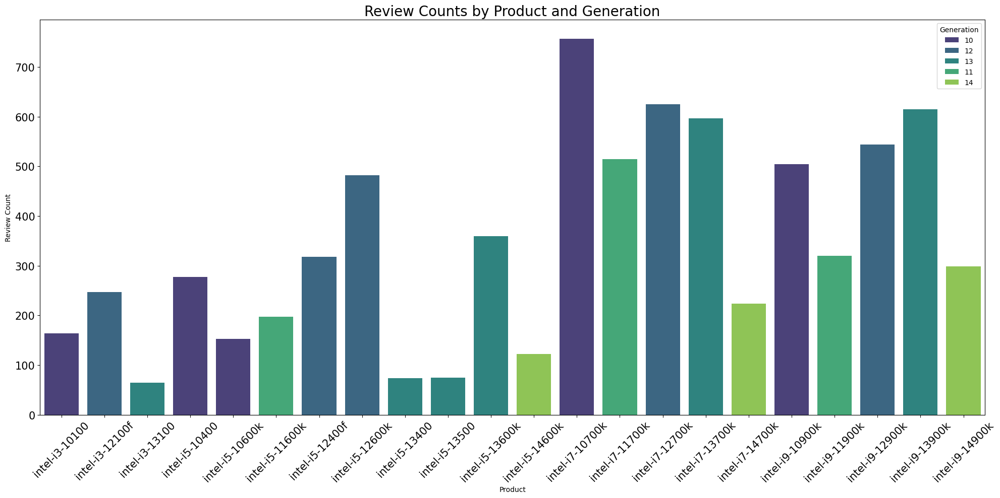

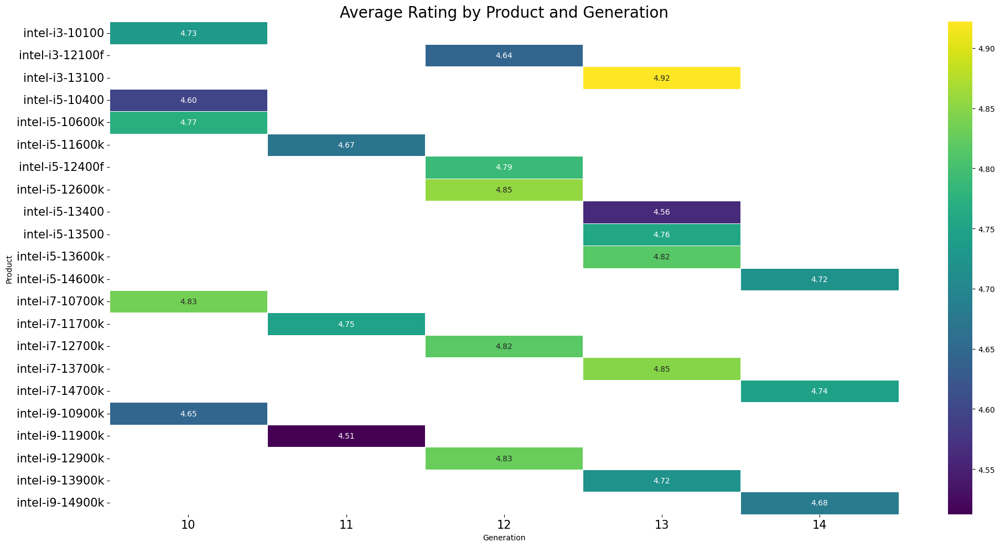

In [51]:
review_counts = data.groupby(['Product', 'Generation'])['Review'].count().reset_index()

plt.figure(figsize=(20, 10))
sns.barplot(x='Product', y='Review', hue='Generation', data=review_counts, palette='viridis')
plt.title('Review Counts by Product and Generation', fontsize=20)
plt.xlabel('Product')
plt.ylabel('Review Count')
plt.yticks(fontsize=15)
plt.xticks(rotation=45,fontsize=15)
plt.legend(title='Generation')
plt.tight_layout()
plt.show()


pivot_table = data.pivot_table(index='Product', columns='Generation', values='Rating', aggfunc='mean')

plt.figure(figsize=(20, 10))
sns.heatmap(pivot_table, cmap='viridis', annot=True, fmt='.2f', linewidths=.5)
plt.title('Average Rating by Product and Generation',fontsize=20)
plt.xlabel('Generation')
plt.ylabel('Product')
plt.yticks(fontsize=15)
plt.xticks(fontsize=15)
plt.tight_layout()
plt.show()

# <div style="padding: 30px; color:white; margin:10; font-size:75%; text-align:left; display:fill; border-radius:10px; background-color:#3b3745"> <b> Exploratory Data Analysis: Data Visualization & Insights </b></div>

Creating a heatmap to visualize the number of reviews by month and year


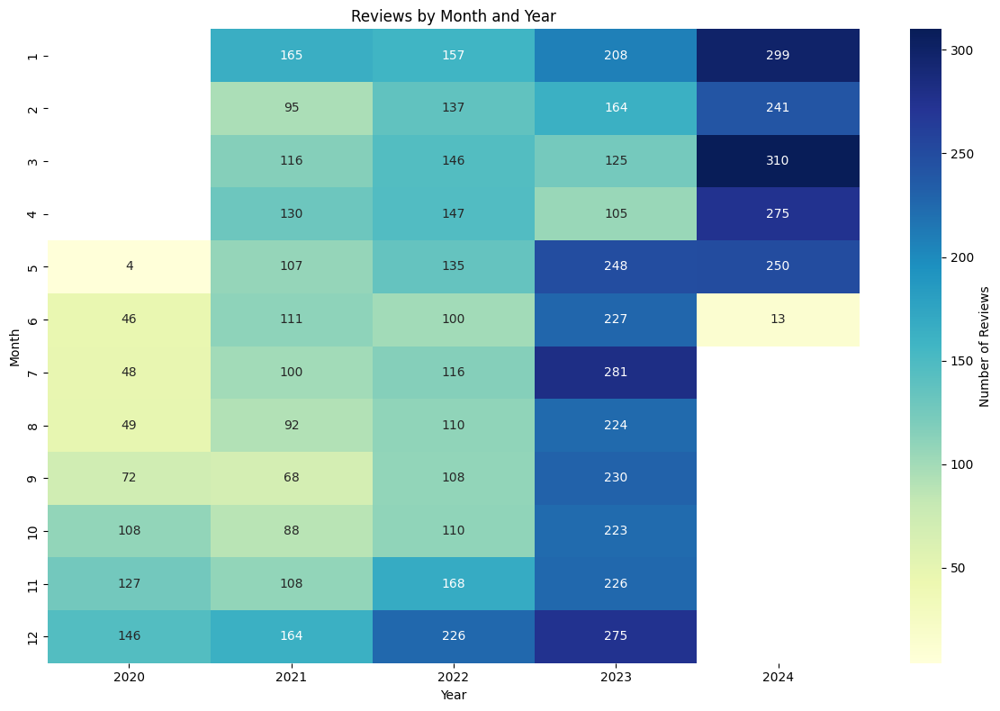

In [52]:
data['Date'] = pd.to_datetime(data['Date'])

data['Year'] = data['Date'].dt.year
data['Month'] = data['Date'].dt.month

monthly_reviews = data.groupby(['Year', 'Month']).size().reset_index(name='Reviews')

pivot_data = monthly_reviews.pivot(index='Month', columns='Year', values='Reviews')

plt.figure(figsize=(12, 8))
sns.heatmap(pivot_data, cmap='YlGnBu', annot=True, fmt='.0f', cbar_kws={'label': 'Number of Reviews'})
plt.title('Reviews by Month and Year')
plt.xlabel('Year')
plt.ylabel('Month')
plt.tight_layout()
plt.show()


<a id="section-6"></a>
<div style="padding: 30px; color:white; margin:10;  text-align:left; display:fill; border-radius:10px; background-color:#3b3745">
    <b><span style='color:#F1A424; font-size: 160%;'> 4 |</span></b> <b style="font-size: 160%;">  Analyzing 'Generation' column </b>
    <p style="margin-top: 5px; font-size: 100%;">This column refers to the different Generations the Processors belong to.</p>
</div>


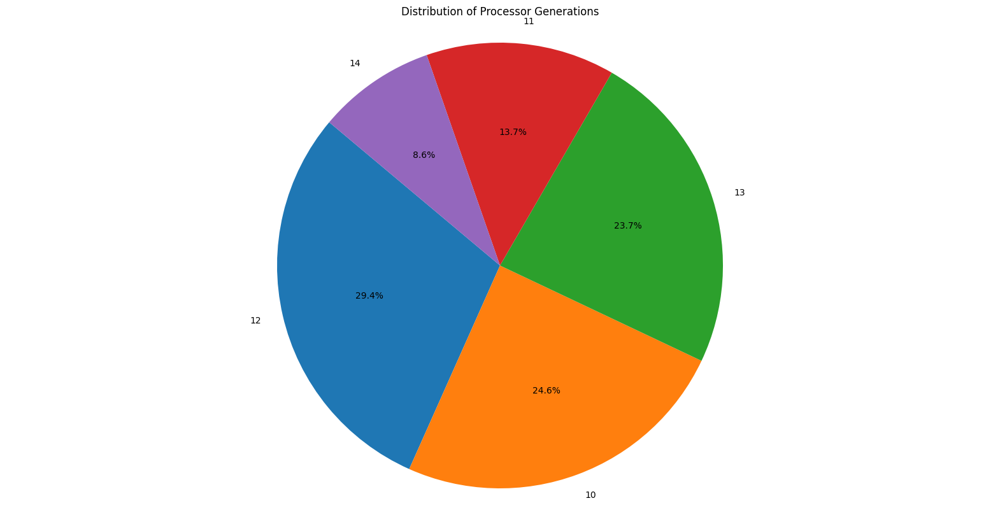

In [53]:
generation_counts = data['Generation'].value_counts()

plt.figure(figsize=(20, 10))
plt.pie(generation_counts, labels=generation_counts.index, autopct='%1.1f%%', startangle=140, colors=plt.cm.tab10.colors)
plt.title('Distribution of Processor Generations')
plt.axis('equal')  
plt.show()

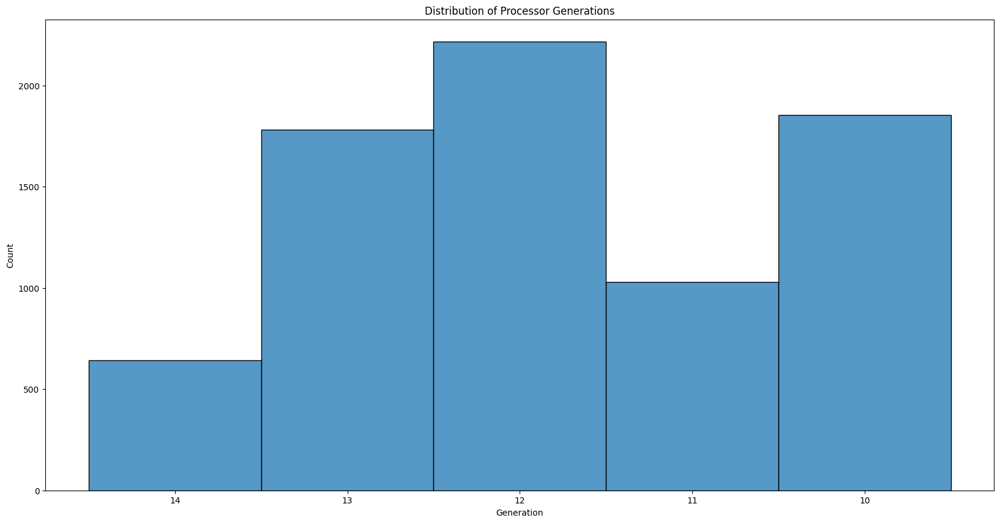

In [54]:
plt.figure(figsize=(20, 10))
sns.histplot(data['Generation'], bins=10, kde=False)
plt.title('Distribution of Processor Generations')
plt.xlabel('Generation')
plt.ylabel('Count')
plt.show()

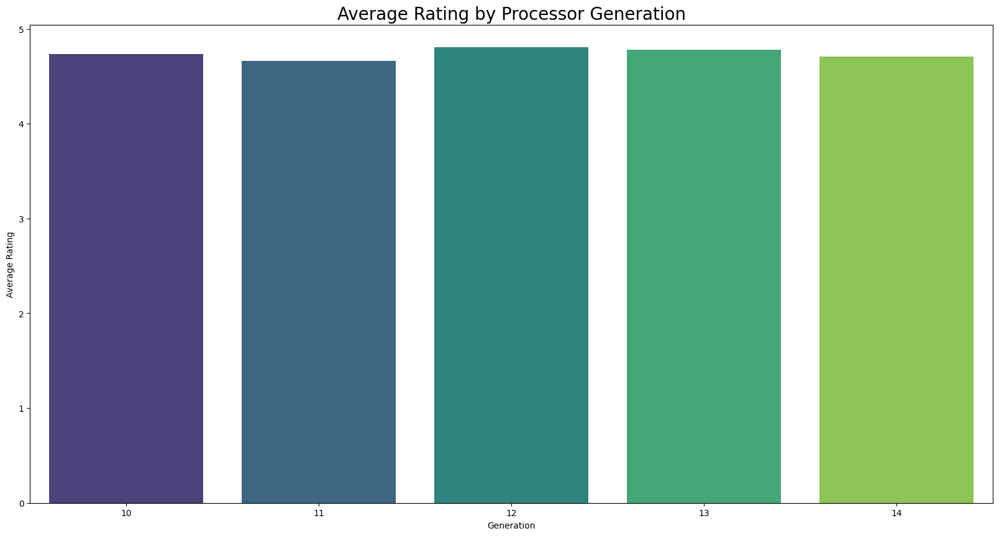

In [55]:
avg_rating = data.groupby('Generation')['Rating'].mean().reset_index()

plt.figure(figsize=(20, 10))
sns.barplot(x='Generation', y='Rating', data=avg_rating, palette='viridis', hue='Generation', dodge=False)
plt.title('Average Rating by Processor Generation', fontsize=20)
plt.xlabel('Generation')
plt.ylabel('Average Rating')
plt.legend([], frameon=False)  
plt.show()

In [56]:
rating_summary = data.groupby('Generation')['Rating'].describe()
print(rating_summary)

             count      mean       std  min  25%  50%  75%  max
Generation                                                     
10          1855.0  4.733693  0.817303  1.0  5.0  5.0  5.0  5.0
11          1031.0  4.660524  0.865287  1.0  5.0  5.0  5.0  5.0
12          2216.0  4.805054  0.654135  1.0  5.0  5.0  5.0  5.0
13          1782.0  4.784512  0.762415  1.0  5.0  5.0  5.0  5.0
14           644.0  4.711180  0.769035  1.0  5.0  5.0  5.0  5.0


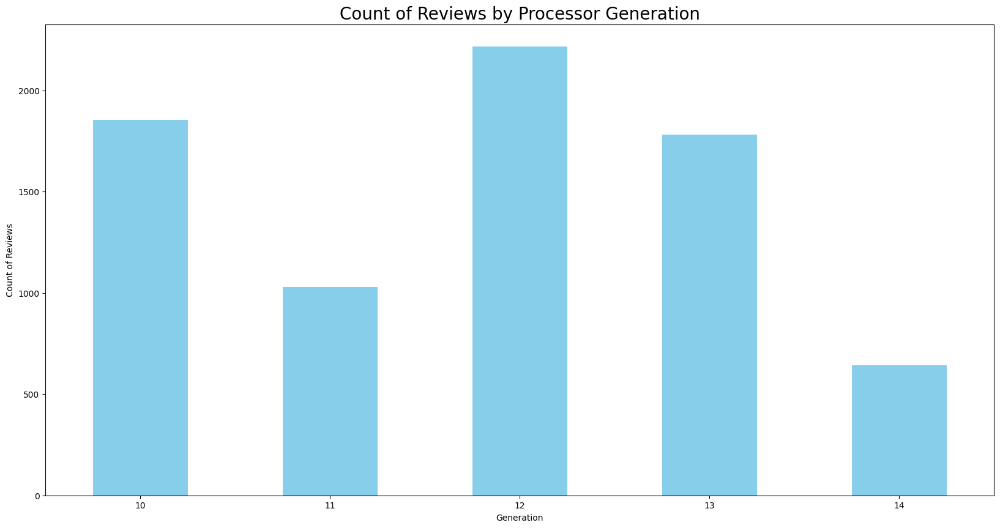

In [57]:
generation_review_counts = data['Generation'].value_counts().sort_index()

plt.figure(figsize=(20, 10))
generation_review_counts.plot(kind='bar', color='skyblue')
plt.title('Count of Reviews by Processor Generation', fontsize=20)
plt.xlabel('Generation')
plt.ylabel('Count of Reviews')
plt.xticks(rotation=0)
plt.show()

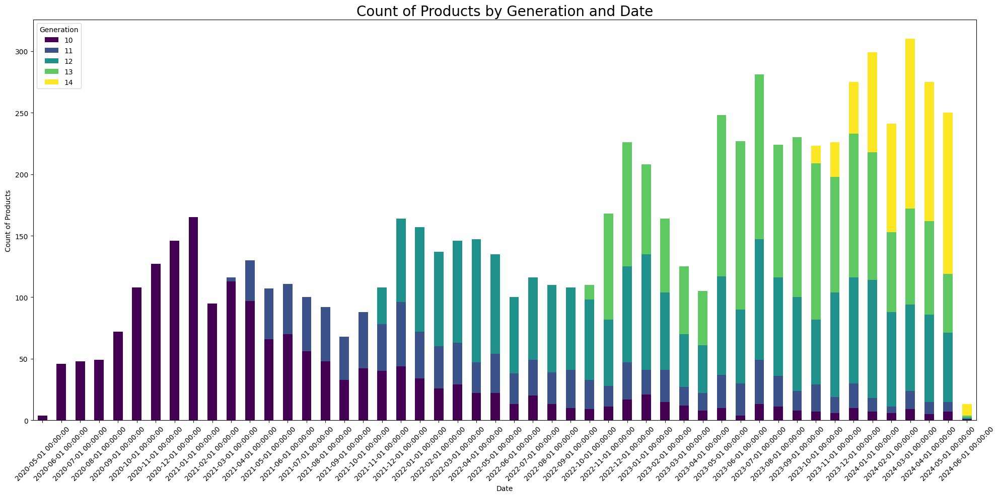

In [58]:
generation_date_counts = data.groupby(['Date', 'Generation']).size().unstack(fill_value=0)

plt.figure(figsize=(20, 10))  

ax = generation_date_counts.plot(kind='bar', stacked=True, colormap='viridis', ax=plt.gca())
ax.set_title('Count of Products by Generation and Date', fontsize=20)
ax.set_xlabel('Date')
ax.set_ylabel('Count of Products')
ax.legend(title='Generation', loc='upper left')
ax.tick_params(axis='x', rotation=45) 
plt.tight_layout()
plt.show()

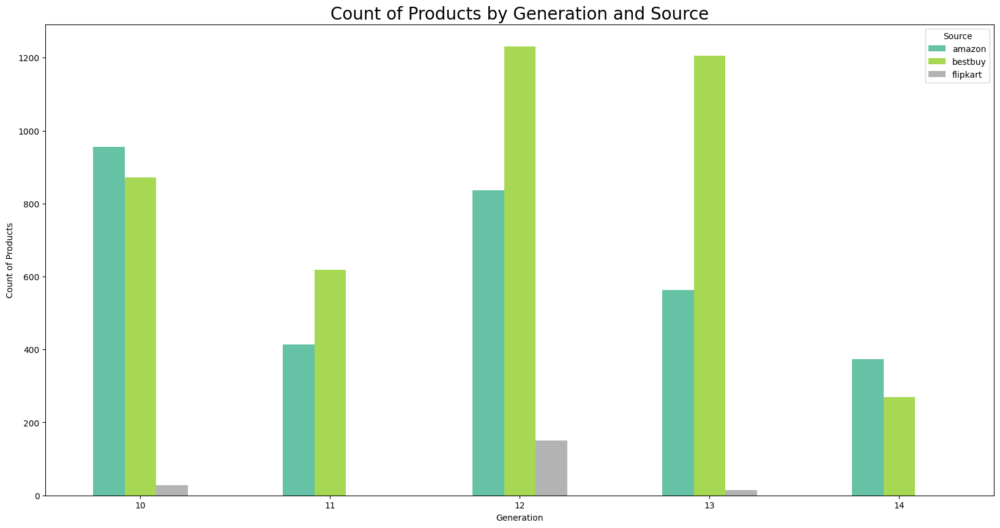

In [59]:
generation_source_counts = data.groupby(['Generation', 'Source']).size().unstack(fill_value=0)

plt.figure(figsize=(20, 10))

ax = generation_source_counts.plot(kind='bar', stacked=False, colormap='Set2', ax=plt.gca())
ax.set_title('Count of Products by Generation and Source', fontsize=20)
ax.set_xlabel('Generation')
ax.set_ylabel('Count of Products')
ax.legend(title='Source', loc='upper right')
ax.tick_params(axis='x', rotation=0)  
plt.show()

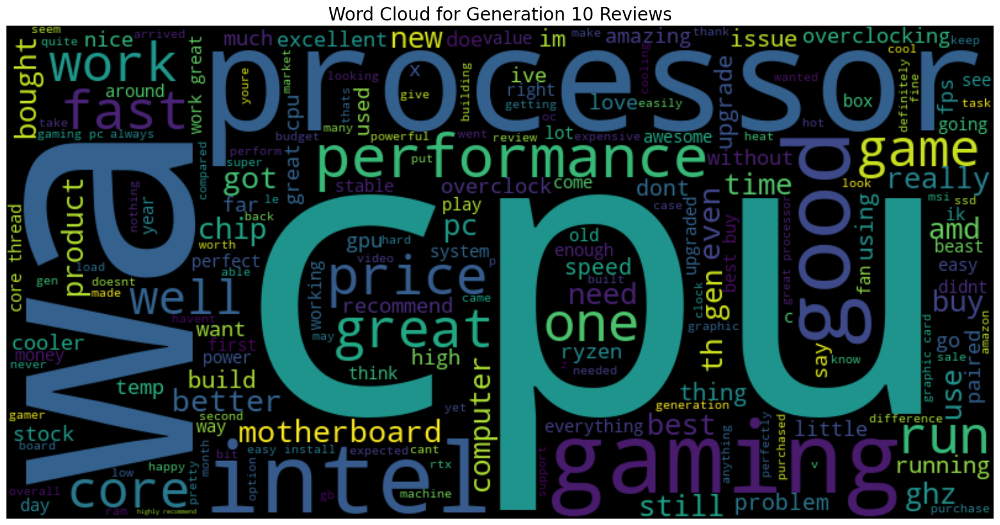

In [60]:
generation_10_reviews = data.loc[data['Generation'] == '10', 'Review'].str.cat(sep=' ')

wordcloud = WordCloud(width=800, height=400, background_color='black').generate(generation_10_reviews)

plt.figure(figsize=(20, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Generation 10 Reviews', fontsize=20)
plt.axis('off')  
plt.show()

Words can be seen in the above word clouds -  good, fast, overclock, perfect, issue, excellent, recommend  etc

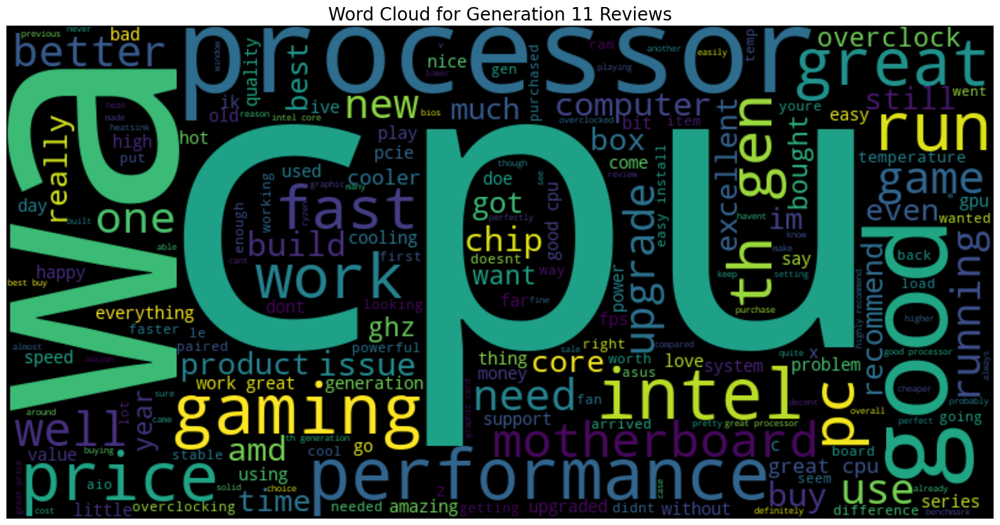

In [61]:
generation_11_reviews = data.loc[data['Generation'] == '11', 'Review'].str.cat(sep=' ')

wordcloud = WordCloud(width=800, height=400, background_color='black').generate(generation_11_reviews)

plt.figure(figsize=(20, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Generation 11 Reviews', fontsize=20)
plt.axis('off')  
plt.show()

Words can be seen in the above word clouds -  good, better, speed, price, fast, stable, happy,temp  etc

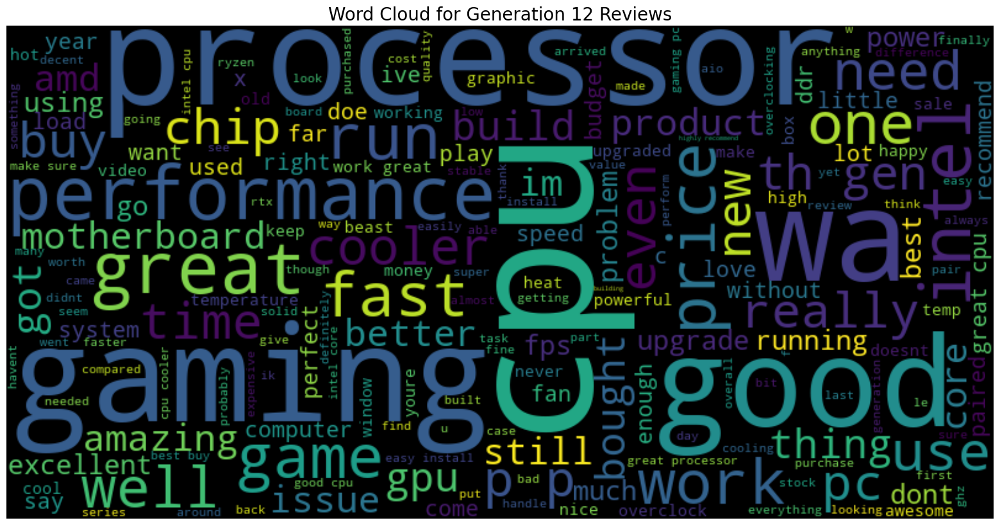

In [62]:
generation_12_reviews = data.loc[data['Generation'] == '12', 'Review'].str.cat(sep=' ')

wordcloud = WordCloud(width=800, height=400, background_color='black').generate(generation_12_reviews)

plt.figure(figsize=(20, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Generation 12 Reviews', fontsize=20)
plt.axis('off')  
plt.show()

Words can be seen in the above word clouds -  gaming, work,fast, power, amazing, budget, beast, cooler, great  etc

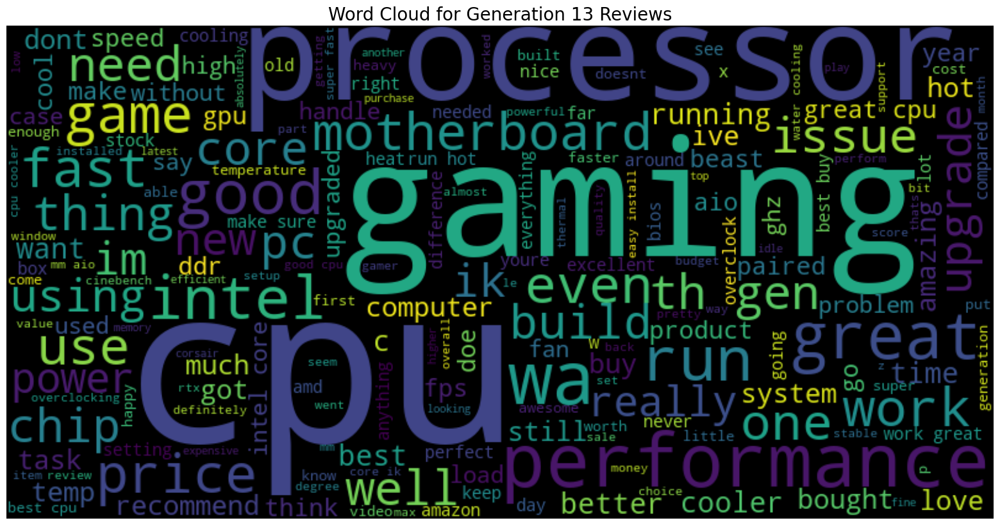

In [63]:
generation_13_reviews = data.loc[data['Generation'] == '13', 'Review'].str.cat(sep=' ')

wordcloud = WordCloud(width=800, height=400, background_color='black').generate(generation_13_reviews)

plt.figure(figsize=(20, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Generation 13 Reviews', fontsize=20)
plt.axis('off')  
plt.show()

Words can be seen in the above word clouds - good, speed, love, hot, stable, old etc

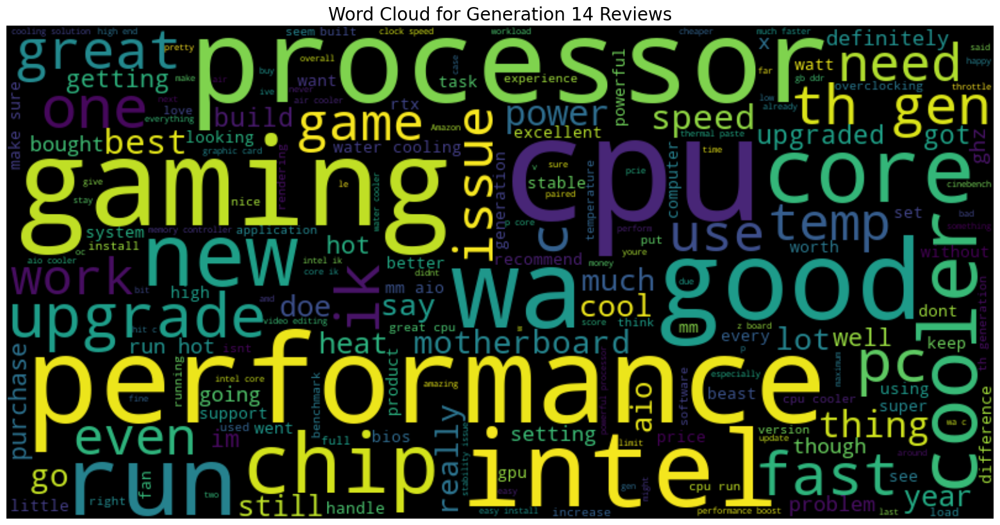

In [64]:
generation_14_reviews = data.loc[data['Generation'] == '14', 'Review'].str.cat(sep=' ')

wordcloud = WordCloud(width=800, height=400, background_color='black').generate(generation_14_reviews)

plt.figure(figsize=(20, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Generation 14 Reviews', fontsize=20)
plt.axis('off')  
plt.show()

Words can be seen in the above word clouds -  gaming, fast, exceleent, heat, price, overclocking  etc


<a id="section-7"></a>
<div style="padding: 30px; color:white; margin:10;  text-align:left; display:fill; border-radius:10px; background-color:#3b3745">
    <b><span style='color:#F1A424; font-size: 160%;'> 5 |</span></b> <b style="font-size: 160%;">  Analyzing 'Source' column </b>
    <p style="margin-top: 5px; font-size: 100%;">This column refers to the different sources the data has been scraped from.</p>
</div>

In [65]:
data.Source.describe()

count        7528
unique          3
top       bestbuy
freq         4194
Name: Source, dtype: object

In [66]:
top_sources = data['Source'].value_counts().head(10)
print("Top Sources:")
print(top_sources)

Top Sources:
Source
bestbuy     4194
amazon      3142
flipkart     192
Name: count, dtype: int64


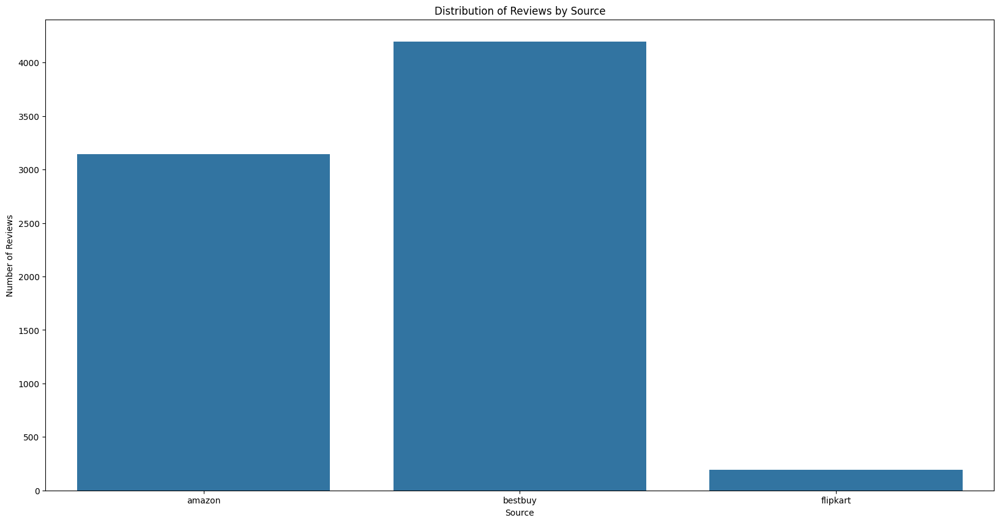

In [67]:
plt.figure(figsize=(20, 10))
sns.countplot(data=data, x='Source')

positions = range(len(data['Source'].unique()))
plt.xticks(positions, data['Source'].unique())

plt.title('Distribution of Reviews by Source')
plt.xlabel('Source')
plt.ylabel('Number of Reviews')
plt.xticks(rotation=0, ha='center')  

plt.show()


In [68]:
print(f"Rating value count - percentage distribution: \n{round(data['Source'].value_counts()/data.shape[0]*100,2)}")

Rating value count - percentage distribution: 
Source
bestbuy     55.71
amazon      41.74
flipkart     2.55
Name: count, dtype: float64


Let's plot this percentage distribution in a pie chart.

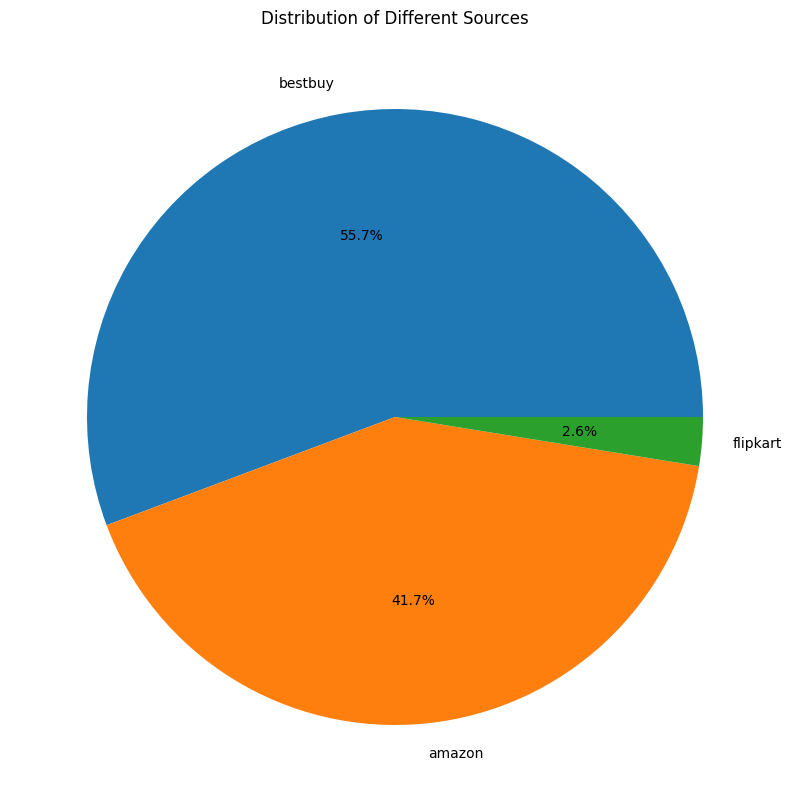

In [69]:
plt.figure(figsize=(20,10))

tags = data['Source'].value_counts()
tags.plot(kind='pie', autopct='%1.1f%%', label='')
plt.title("Distribution of Different Sources")
plt.show()

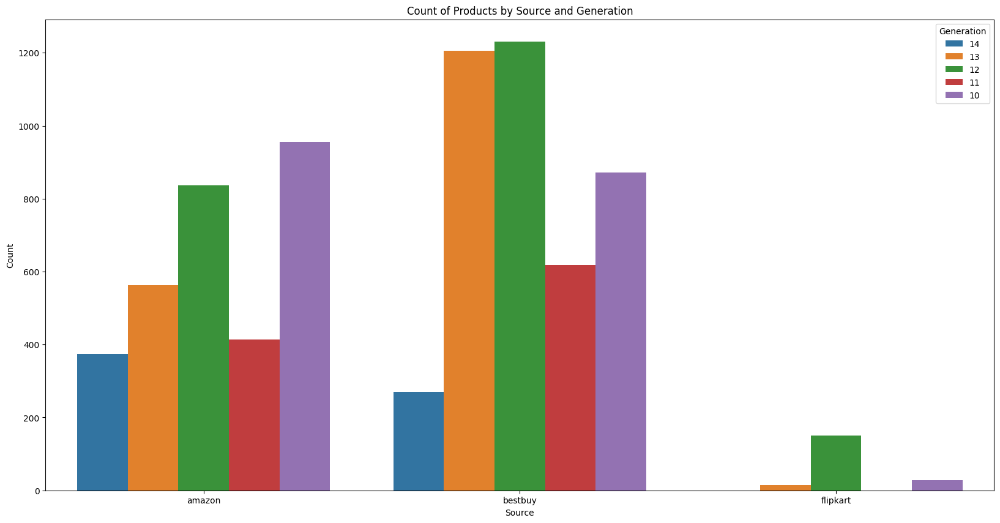

In [70]:
plt.figure(figsize=(20, 10))
sns.countplot(x='Source', hue='Generation', data=data)
plt.title('Count of Products by Source and Generation')
plt.xlabel('Source')
plt.ylabel('Count')
plt.legend(title='Generation')
plt.xticks(rotation=0)
plt.show()

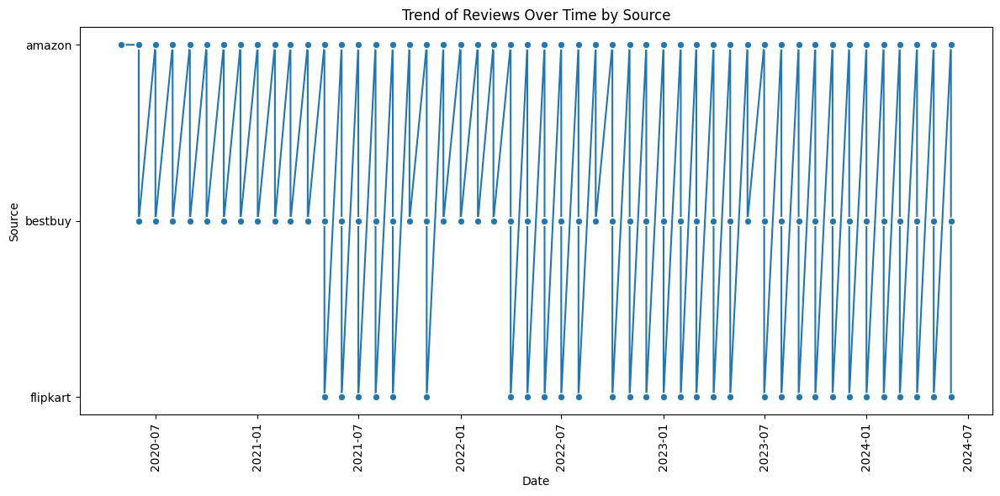

In [71]:
data['Date'] = pd.Categorical(data['Date'], categories=sorted(data['Date'].unique()), ordered=True)

plt.figure(figsize=(12, 6))
sns.lineplot(data=data, x='Date', y='Source', estimator=None, marker='o')
plt.title('Trend of Reviews Over Time by Source')
plt.xlabel('Date')
plt.ylabel('Source')
plt.xticks(rotation=90)  
plt.tight_layout()  
plt.show()

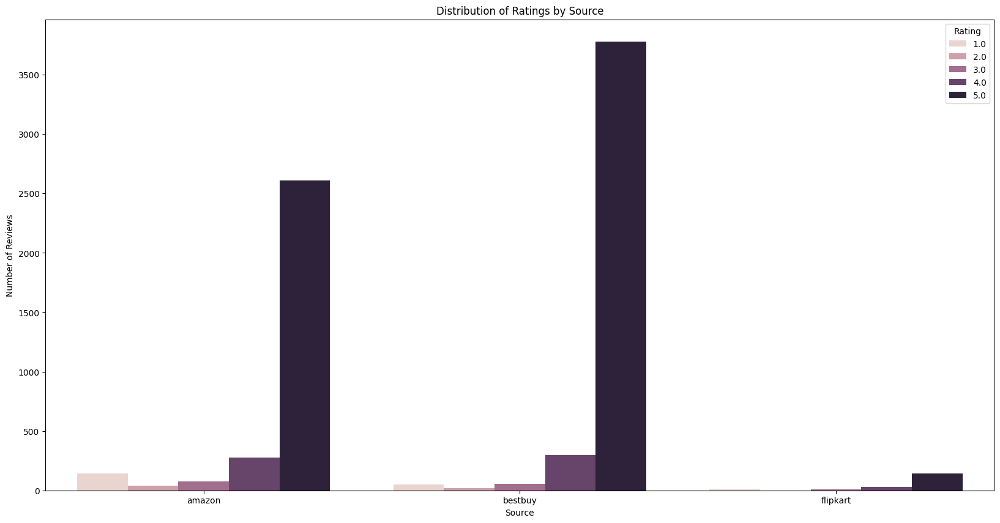

In [72]:
plt.figure(figsize=(20, 10))
sns.countplot(data=data, x='Source', hue='Rating')

positions = range(len(data['Source'].unique()))
plt.xticks(positions, data['Source'].unique())

plt.title('Distribution of Ratings by Source')
plt.xlabel('Source')
plt.ylabel('Number of Reviews')
plt.xticks(rotation=0, ha='center')  

plt.legend(title='Rating')
plt.show()


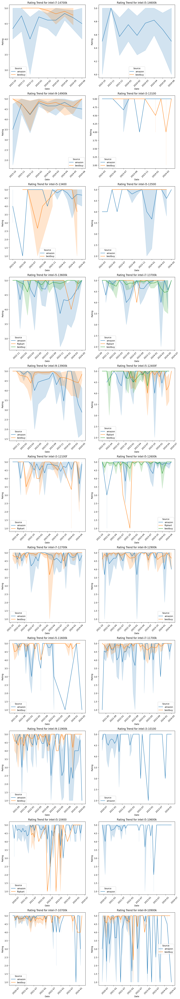

In [73]:
unique_products = data['Product'].unique()

num_plots = len(unique_products)
num_cols = 2 
num_rows = (num_plots + 1) // num_cols  

fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 6 * num_rows))

axes = axes.flatten()

for i, product in enumerate(unique_products):
    product_data = data[data['Product'] == product]
    
    for source in product_data['Source'].unique():
        source_data = product_data[product_data['Source'] == source]
        sns.lineplot(x='Date', y='Rating', data=source_data, label=source, ax=axes[i])
    
    axes[i].set_title(f'Rating Trend for {product}')
    axes[i].set_xlabel('Date')
    axes[i].set_ylabel('Rating')
    axes[i].legend(title='Source')
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

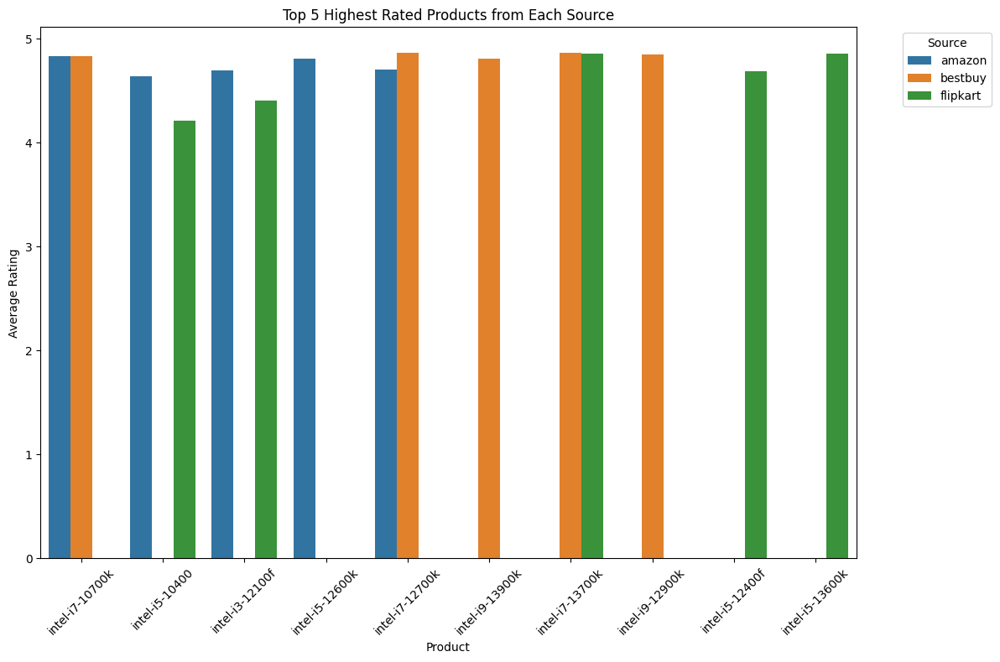

In [74]:
def count_5_star_ratings(ratings):
    return (ratings == 5).sum()

grouped = data.groupby(['Source', 'Product']).agg({'Rating': ['mean', count_5_star_ratings, 'count']}).reset_index()
grouped.columns = ['Source', 'Product', 'Average Rating', 'Number of 5-Star Ratings', 'Total Ratings']

grouped['Weighted Score'] = grouped['Average Rating'] * grouped['Number of 5-Star Ratings']

grouped.sort_values(by=['Source', 'Weighted Score'], ascending=[True, False], inplace=True)

top_products = {}
for source, group_data in grouped.groupby('Source'):
    top_products[source] = group_data.head(5)

top_rated_products = pd.concat(top_products.values())

plt.figure(figsize=(12, 8))
sns.barplot(data=top_rated_products, x='Product', y='Average Rating', hue='Source', dodge=True)
plt.title('Top 5 Highest Rated Products from Each Source')
plt.xlabel('Product')
plt.ylabel('Average Rating')
plt.xticks(rotation=45)
plt.legend(title='Source', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


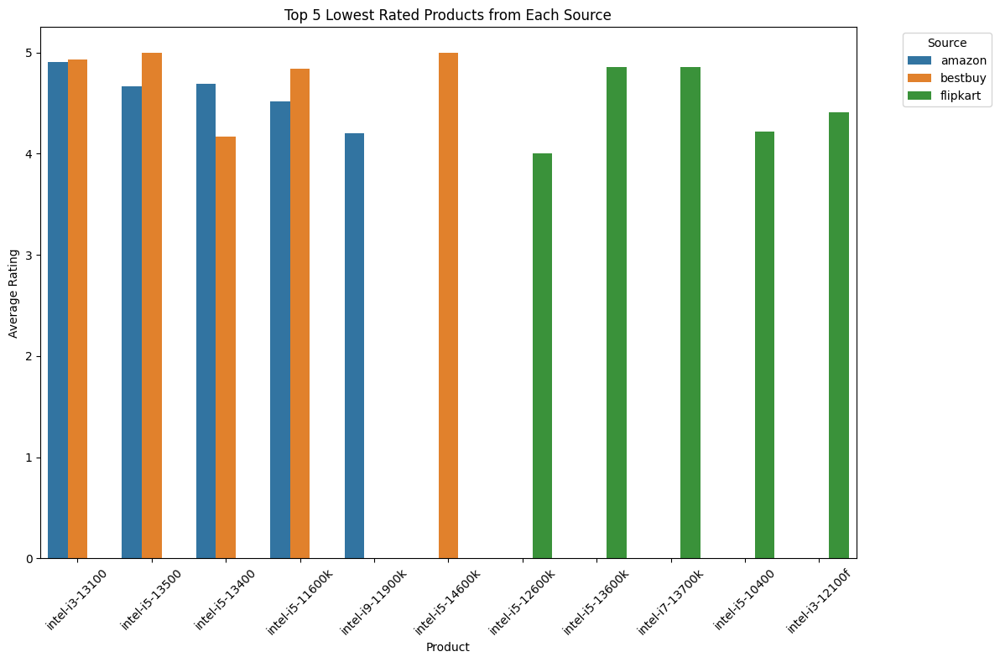

In [75]:
def count_5_star_ratings(ratings):
    return (ratings == 5).sum()

grouped = data.groupby(['Source', 'Product']).agg({'Rating': ['mean', count_5_star_ratings, 'count']}).reset_index()
grouped.columns = ['Source', 'Product', 'Average Rating', 'Number of 5-Star Ratings', 'Total Ratings']

grouped['Weighted Score'] = grouped['Average Rating'] * grouped['Number of 5-Star Ratings']

grouped.sort_values(by=['Source', 'Weighted Score'], ascending=[True, True], inplace=True)

bottom_products = {}
for source, group_data in grouped.groupby('Source'):
    bottom_products[source] = group_data.head(5)

bottom_rated_products = pd.concat(bottom_products.values())

plt.figure(figsize=(12, 8))
sns.barplot(data=bottom_rated_products, x='Product', y='Average Rating', hue='Source', dodge=True)
plt.title('Top 5 Lowest Rated Products from Each Source')
plt.xlabel('Product')
plt.ylabel('Average Rating')
plt.xticks(rotation=45)
plt.legend(title='Source', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


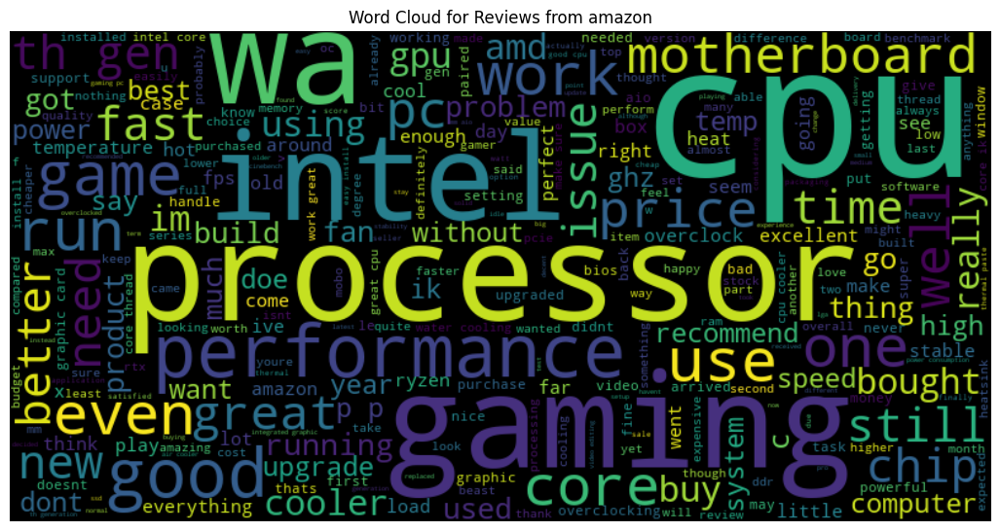

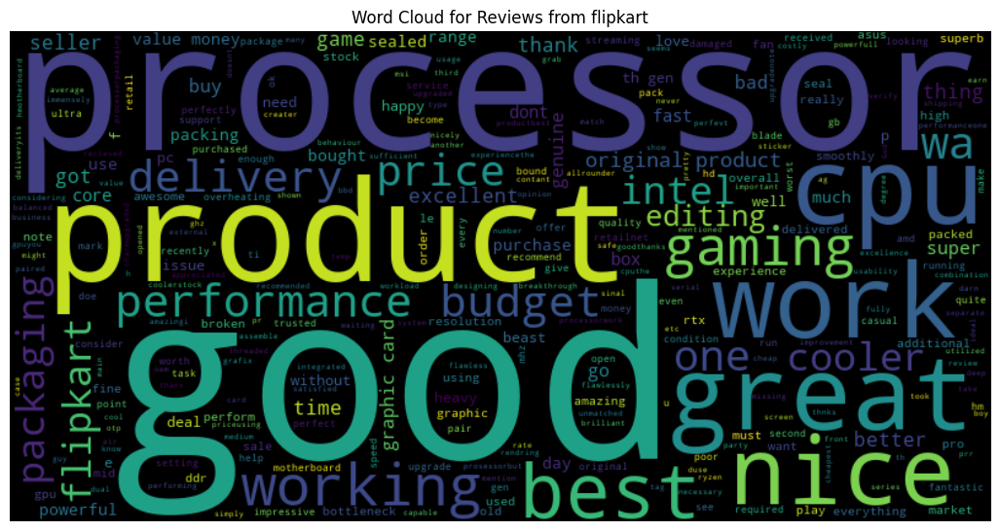

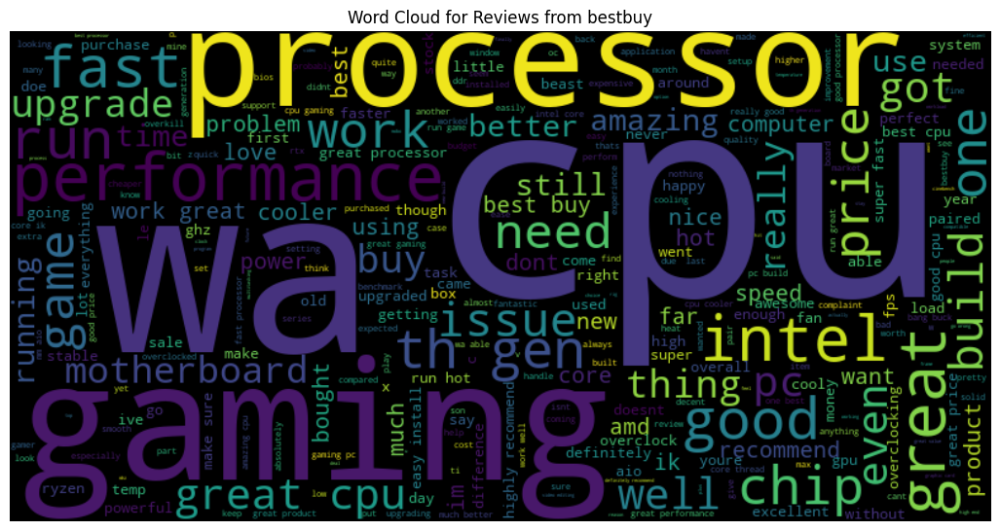

In [76]:
def generate_wordcloud(source):
    wordcloud = WordCloud(width=800, height=400, max_words=300, background_color='black').generate(' '.join(data[data['Source'] == source]['Review']))
    plt.figure(figsize=(13, 10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for Reviews from {source}')
    plt.axis('off')
    plt.show()

generate_wordcloud('amazon')
generate_wordcloud('flipkart')
generate_wordcloud('bestbuy')


Words can be seen in the above word clouds -  great, fast, hot, best, nice, excellent, stable, overclock, issue  etc

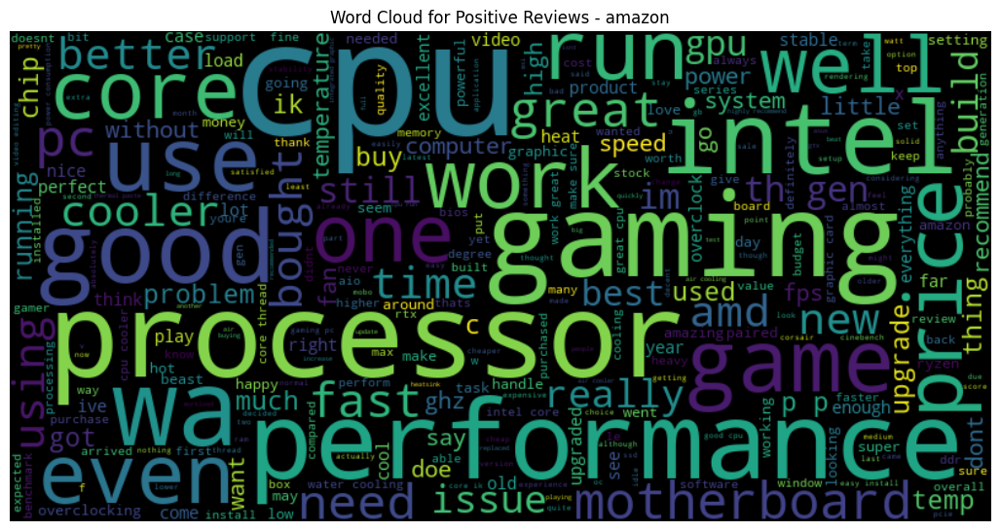

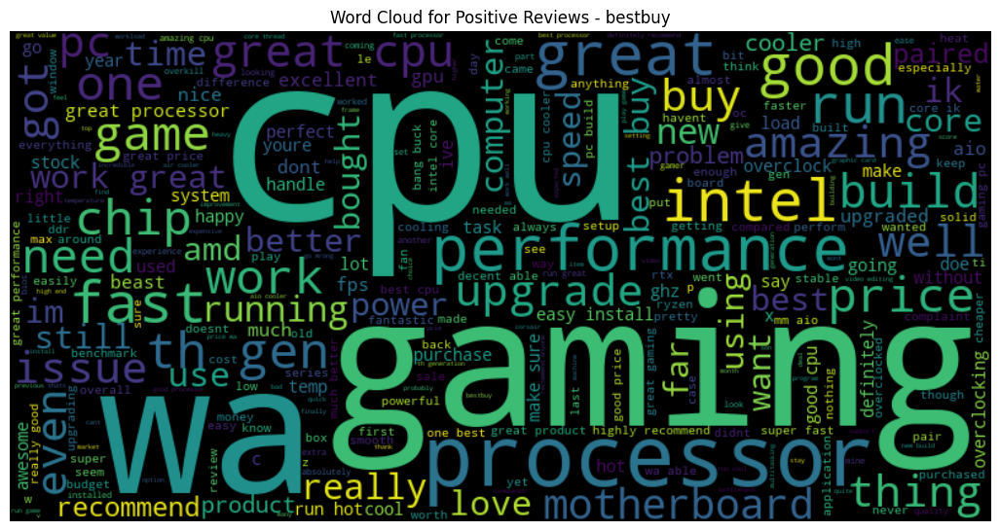

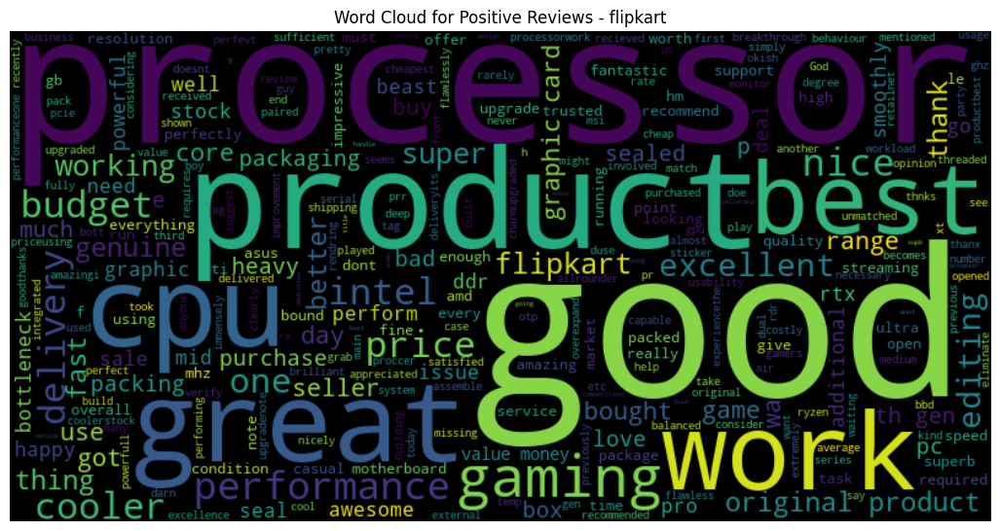

In [77]:
positive_reviews = data[data['Rating'] == 5]

grouped_reviews = positive_reviews.groupby('Source')['Review'].apply(lambda x: ' '.join(x)).reset_index()

for i, row in grouped_reviews.iterrows():
    source = row['Source']
    text = row['Review']
    
    wordcloud = WordCloud(width=800, height=400, max_words=300, background_color='black').generate(text)
    
    plt.figure(figsize=(13, 10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for Positive Reviews - {source}')
    plt.axis('off')
    plt.show()


Positive words can be seen in the above word clouds - good, great, best, excellent, amazing, happy, fast, perfect etc

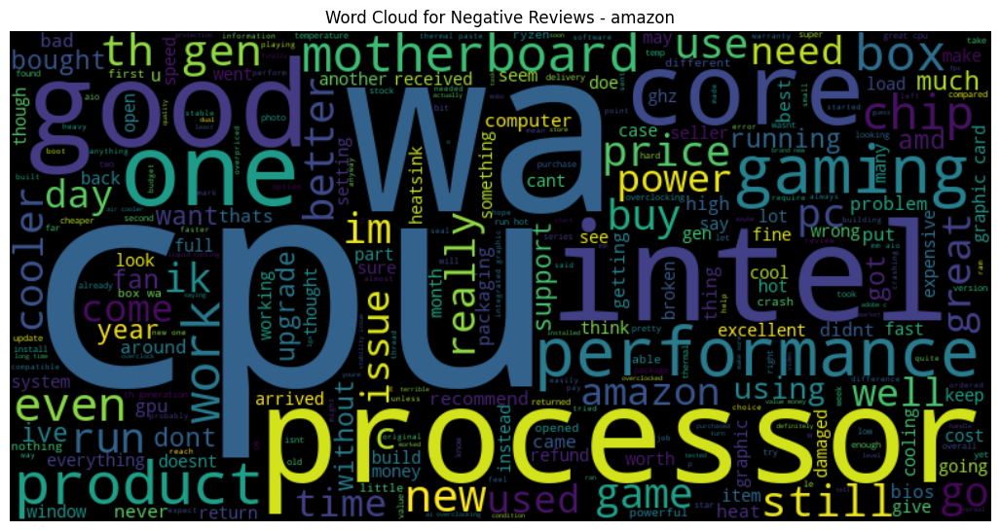

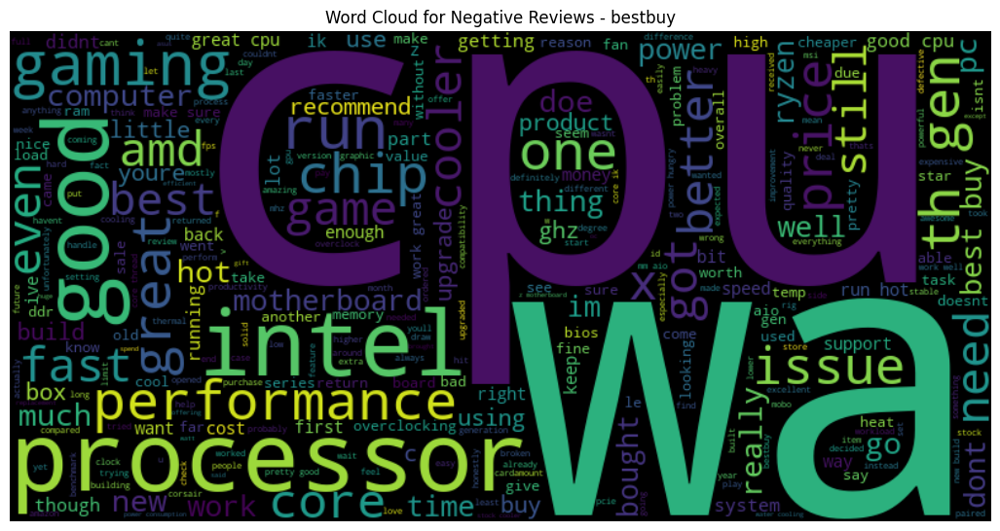

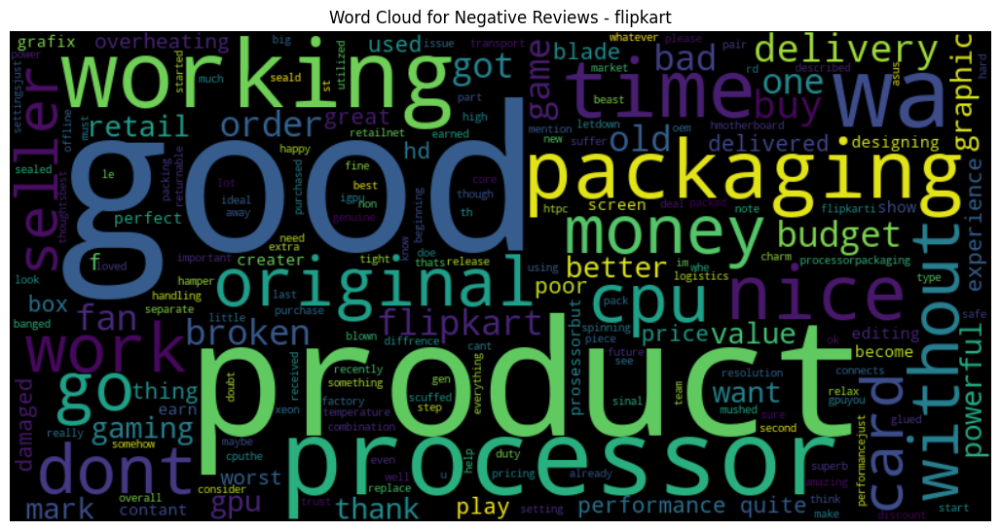

In [78]:
negative_reviews = data[data['Rating'] < 5]

grouped_reviews = negative_reviews.groupby('Source')['Review'].apply(lambda x: ' '.join(x)).reset_index()

for i, row in grouped_reviews.iterrows():
    source = row['Source']
    text = row['Review']
    
    wordcloud = WordCloud(width=800, height=400, max_words=300, background_color='black').generate(text)
    
    plt.figure(figsize=(13, 10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for Negative Reviews - {source}')
    plt.axis('off')
    plt.show()


Negative words can be seen in the above word cloud - bad, broken, overheating, heat, expensive, damaged etc

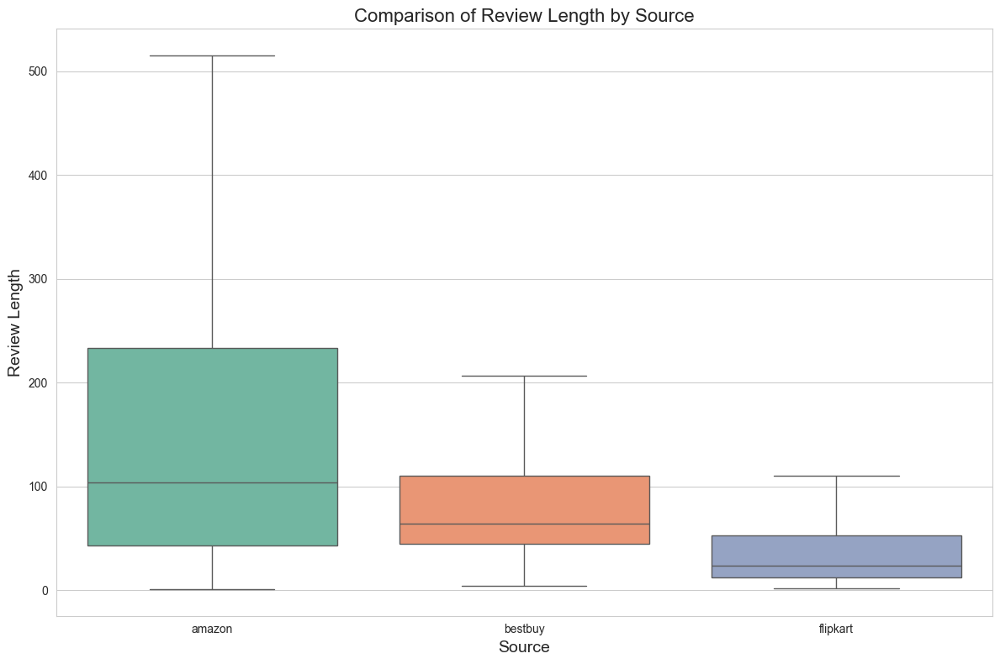

In [79]:
sns.set_style("whitegrid")

plt.figure(figsize=(12, 8))

sns.boxplot(data=data, x='Source', y='Length', hue='Source', showfliers=False, palette='Set2', dodge=False)

plt.title('Comparison of Review Length by Source', fontsize=16)
plt.xlabel('Source', fontsize=14)
plt.ylabel('Review Length', fontsize=14)

positions = range(len(data['Source'].unique()))
plt.xticks(positions, data['Source'].unique())

plt.xticks(rotation=0, ha='center')

warnings.filterwarnings("ignore", category=UserWarning)

plt.legend().remove()

plt.tight_layout()
plt.show()


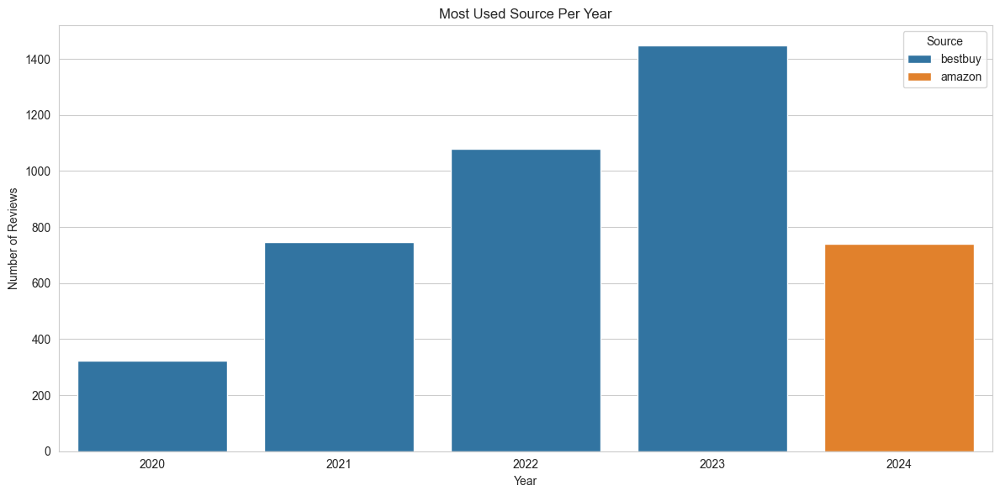

In [80]:
data['Date'] = pd.to_datetime(data['Date'])

data['year'] = data['Date'].dt.year

most_used_sources_per_year = data.groupby(['year', 'Source']).size().reset_index(name='review_count')
most_used_sources_per_year = most_used_sources_per_year.loc[most_used_sources_per_year.groupby('year')['review_count'].idxmax()]

plt.figure(figsize=(12, 6))
sns.barplot(data=most_used_sources_per_year, x='year', y='review_count', hue='Source')
plt.title('Most Used Source Per Year')
plt.xlabel('Year')
plt.ylabel('Number of Reviews')
plt.xticks(rotation=0)
plt.legend(title='Source', bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()


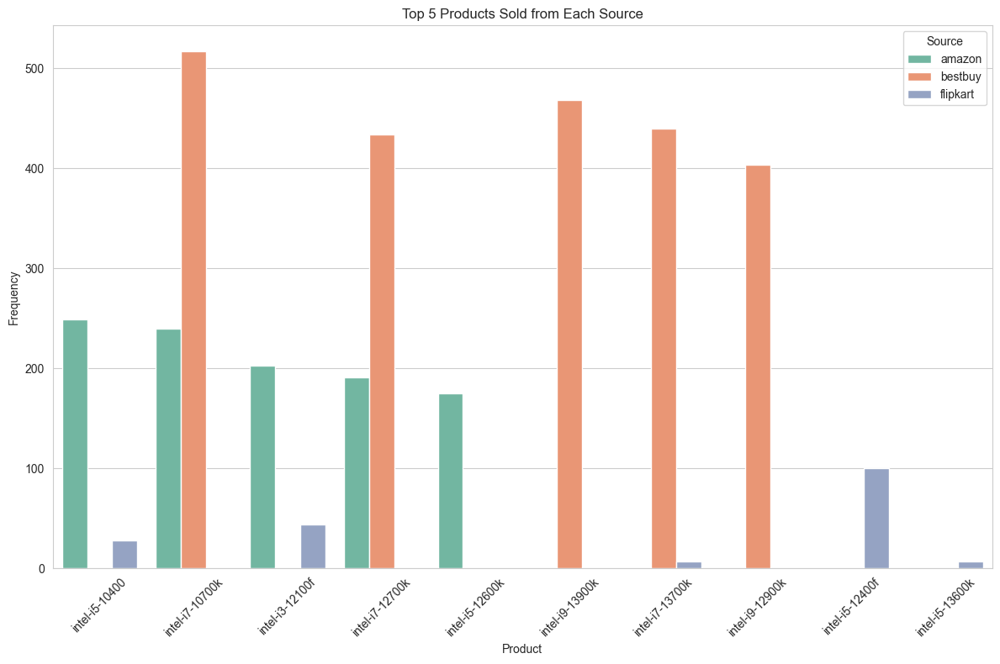

In [81]:
grouped = data.groupby(['Source', 'Product']).size().reset_index(name='Frequency')

sorted_grouped = grouped.sort_values(by=['Source', 'Frequency'], ascending=[True, False])

top_products = sorted_grouped.groupby('Source').head(5)

plt.figure(figsize=(12, 8))
sns.barplot(data=top_products, x='Product', y='Frequency', hue='Source', palette='Set2')
plt.title('Top 5 Products Sold from Each Source')
plt.xlabel('Product')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.legend(title='Source')
plt.tight_layout()
plt.show()


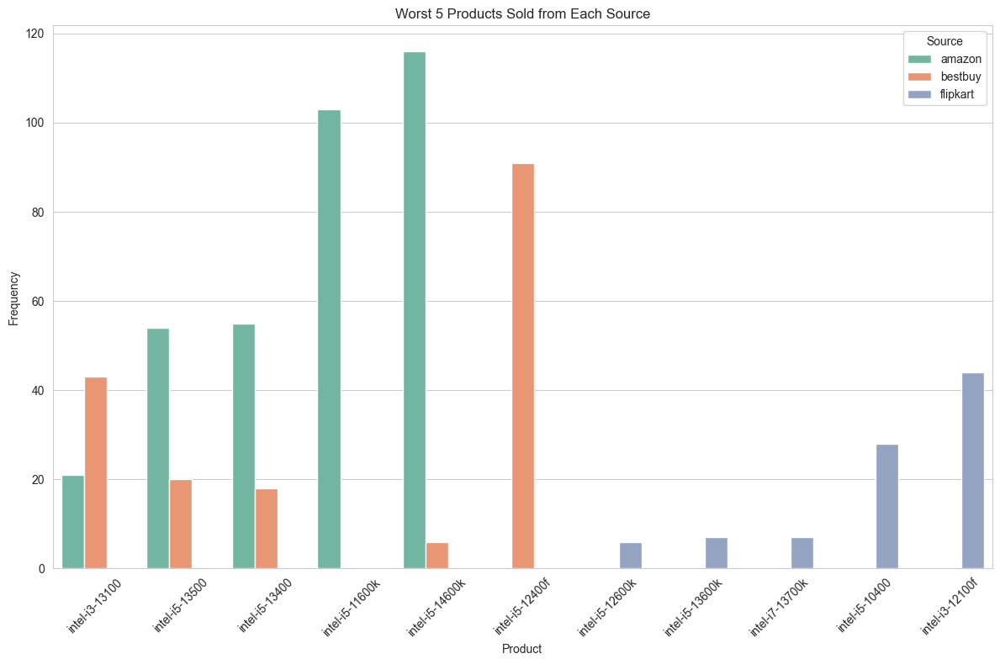

In [82]:
grouped = data.groupby(['Source', 'Product']).size().reset_index(name='Frequency')

sorted_grouped = grouped.sort_values(by=['Source', 'Frequency'], ascending=[True, True])

worst_products = sorted_grouped.groupby('Source').head(5)

plt.figure(figsize=(12, 8))
sns.barplot(data=worst_products, x='Product', y='Frequency', hue='Source', palette='Set2')
plt.title('Worst 5 Products Sold from Each Source')
plt.xlabel('Product')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.legend(title='Source')
plt.tight_layout()
plt.show()


<a id="section-8"></a>
<div style="padding: 30px; color:white; margin:10;  text-align:left; display:fill; border-radius:10px; background-color:#3b3745">
    <b><span style='color:#F1A424; font-size: 160%;'> 6 |</span></b> <b style="font-size: 160%;">  Analyzing 'Rating' column </b>
    <p style="margin-top: 5px; font-size: 100%;">This column refers to the rating of the variation given by the user.</p>
</div>

In [83]:
data.Rating.describe()

count    7528.000000
mean        4.754782
std         0.763813
min         1.000000
25%         5.000000
50%         5.000000
75%         5.000000
max         5.000000
Name: Rating, dtype: float64

In [84]:
data.Rating.skew()

-3.7606671328321277

The skewness of the "Rating" column in the dataset is -3.760667

In [85]:
data.Rating.kurt()

14.303810696183188

The kurtosis of the "Rating" column in the dataset is 14.30381

In [86]:
print(f"Rating value count: \n{data['Rating'].value_counts()}")

Rating value count: 
Rating
5.0    6528
4.0     608
1.0     199
3.0     137
2.0      56
Name: count, dtype: int64


Let's plot the above values in a bar graph

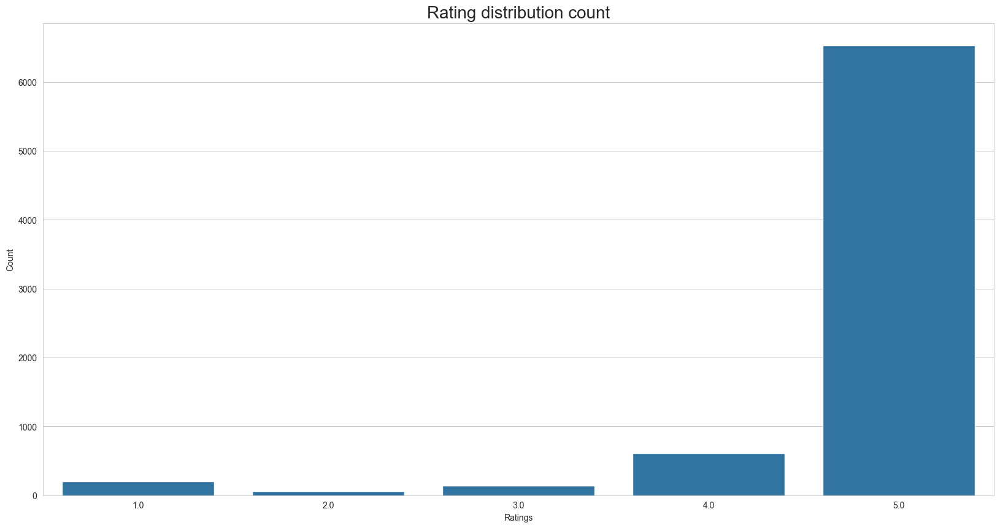

In [87]:
plt.figure(figsize=(20,10))
sns.countplot(x='Rating', data=data)
plt.title('Rating distribution count', fontsize=20)
plt.xlabel('Ratings')
plt.ylabel('Count')
plt.show()

In [88]:
print(f"Rating value count - percentage distribution: \n{round(data['Rating'].value_counts()/data.shape[0]*100,2)}")

Rating value count - percentage distribution: 
Rating
5.0    86.72
4.0     8.08
1.0     2.64
3.0     1.82
2.0     0.74
Name: count, dtype: float64


Let's plot the above values in a pie chart

Ratings distribution

86.72% reviews are 5 stars <br/>
8.08% reviews are 4 stars <br/>
2.64% reviews are 1 stars <br/>
1.82% reviews are 3 stars <br/>
0.74% reviews are 2 stars <br/>


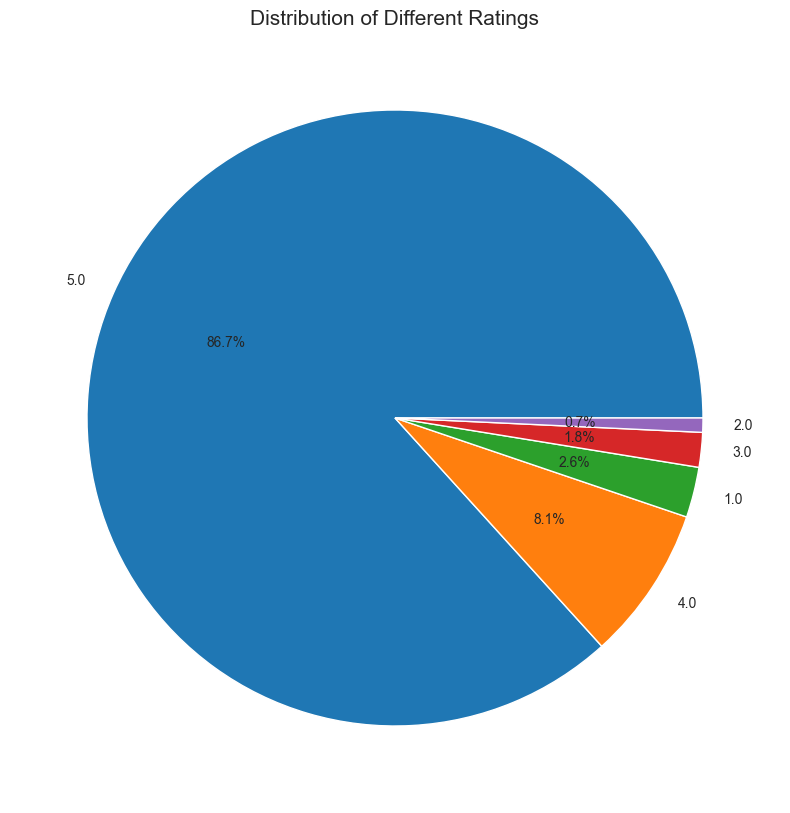

In [89]:
plt.figure(figsize=(20,10))

tags = data['Rating'].value_counts()
tags.plot(kind='pie', autopct='%1.1f%%', label='')
plt.title("Distribution of Different Ratings", fontsize=15)
plt.show()

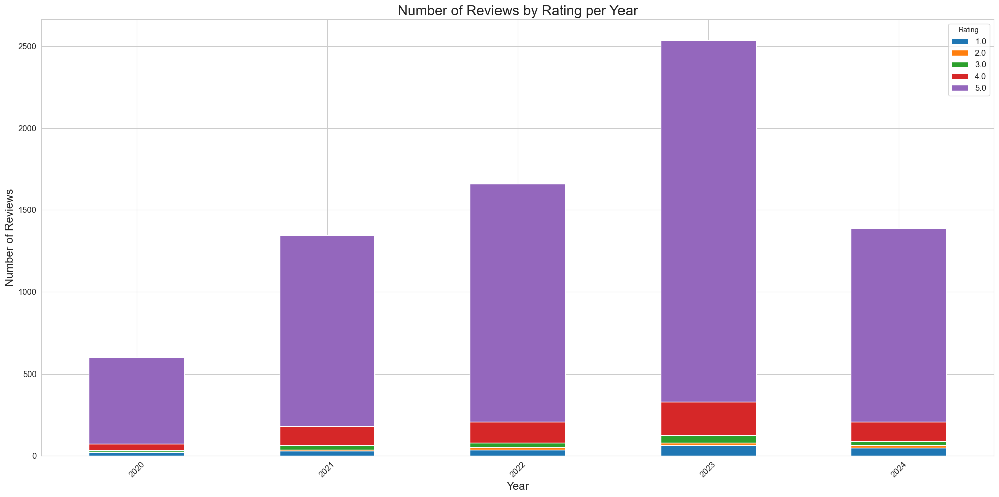

In [90]:
data['Date'] = pd.to_datetime(data['Date'])

data['Year'] = data['Date'].dt.year

ratings_data = data[data['Rating'].isin([1, 2, 3, 4, 5])]

rating_counts = ratings_data.groupby(['Year', 'Rating']).size().unstack(fill_value=0)

fig, ax = plt.subplots(figsize=(20, 10))
rating_counts.plot(kind='bar', stacked=True, ax=ax)
ax.set_title('Number of Reviews by Rating per Year', fontsize=20)
ax.set_xlabel('Year', fontsize=16)
ax.set_ylabel('Number of Reviews', fontsize=16)
ax.tick_params(axis='x', labelrotation=45, labelsize=12)
ax.tick_params(axis='y', labelsize=12)
ax.legend(title='Rating', fontsize=12)
plt.tight_layout()
plt.show()


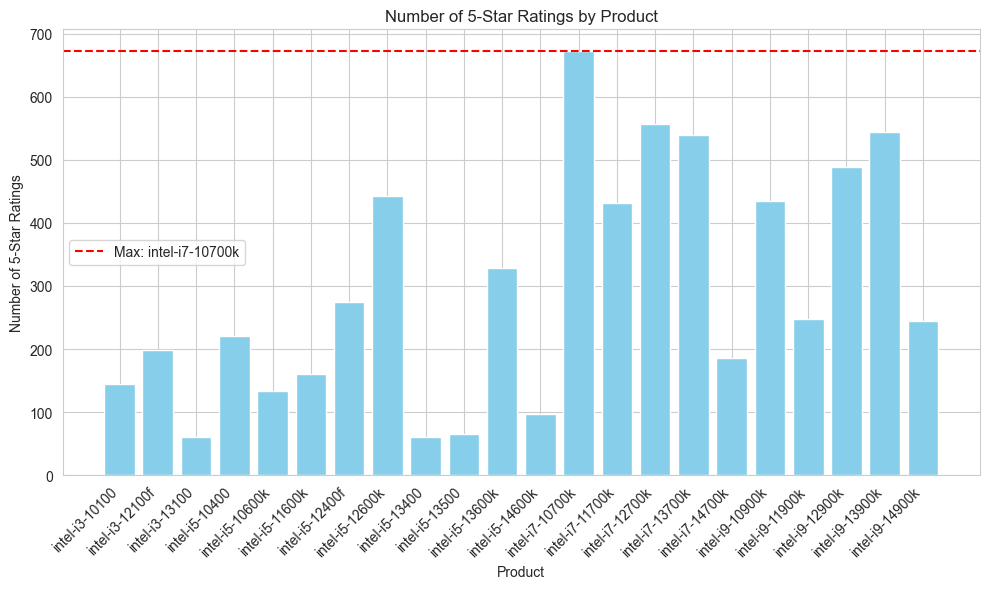

In [91]:
five_star_ratings = data[data['Rating'] == 5]

product_ratings_count = five_star_ratings.groupby('Product').size().reset_index(name='Number of 5-Star Ratings')

max_5_star_product = product_ratings_count.loc[product_ratings_count['Number of 5-Star Ratings'].idxmax()]

plt.figure(figsize=(10, 6))
plt.bar(product_ratings_count['Product'], product_ratings_count['Number of 5-Star Ratings'], color='skyblue')
plt.title('Number of 5-Star Ratings by Product')
plt.xlabel('Product')
plt.ylabel('Number of 5-Star Ratings')
plt.xticks(rotation=45, ha='right')
plt.axhline(y=max_5_star_product['Number of 5-Star Ratings'], color='red', linestyle='--', label=f"Max: {max_5_star_product['Product']}")
plt.legend()
plt.tight_layout()
plt.show()


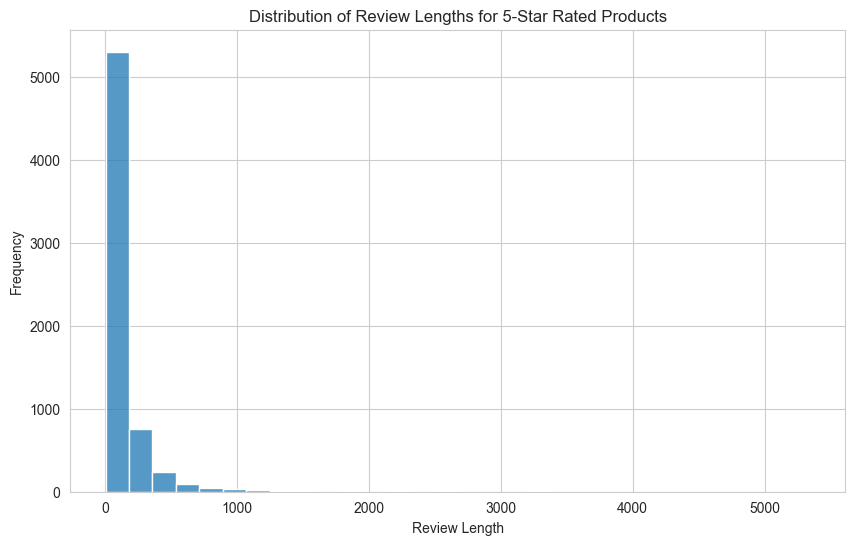

In [92]:
five_star_data = data[data['Rating'] == 5]

plt.figure(figsize=(10, 6))
sns.histplot(data=five_star_data, x='Length', bins=30)
plt.title('Distribution of Review Lengths for 5-Star Rated Products')
plt.xlabel('Review Length')
plt.ylabel('Frequency')
plt.show()


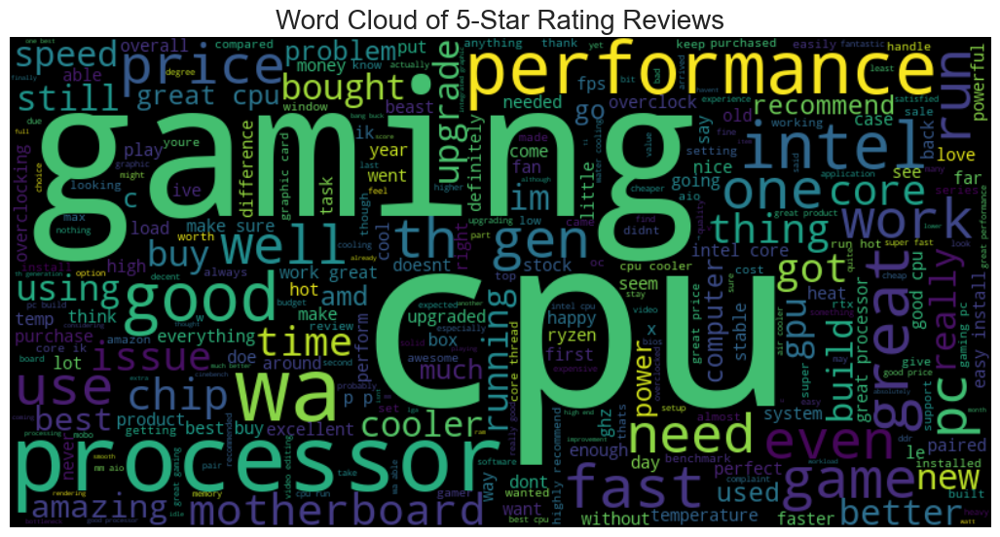

In [93]:
five_star_reviews = data[data['Rating'] == 5]['Review']

text = ' '.join(five_star_reviews)

wordcloud = WordCloud(width=800, height=400, max_words=300, background_color='black').generate(text)

plt.figure(figsize=(13, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud of 5-Star Rating Reviews', fontsize=20)
plt.axis('off')
plt.show()


Words can be seen in the above word cloud - great, amazing, upgrade, good, stable, better, cooler, beast etc <br/>
There are mostly all positive words.

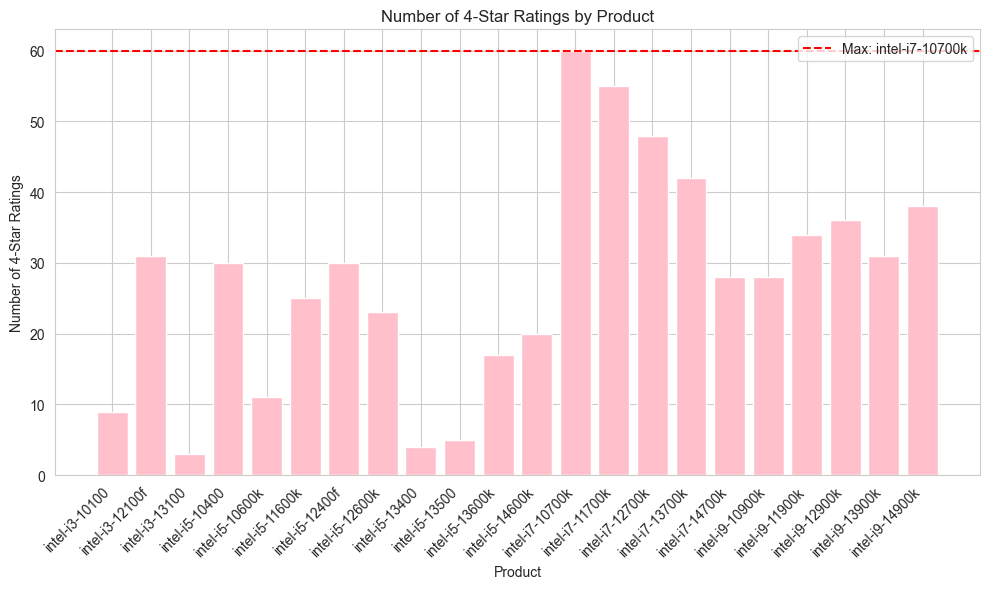

In [94]:

four_star_ratings = data[data['Rating'] == 4]

product_ratings_count = four_star_ratings.groupby('Product').size().reset_index(name='Number of 4-Star Ratings')

max_4_star_product = product_ratings_count.loc[product_ratings_count['Number of 4-Star Ratings'].idxmax()]

plt.figure(figsize=(10, 6))
plt.bar(product_ratings_count['Product'], product_ratings_count['Number of 4-Star Ratings'], color='pink')
plt.title('Number of 4-Star Ratings by Product')
plt.xlabel('Product')
plt.ylabel('Number of 4-Star Ratings')
plt.xticks(rotation=45, ha='right')
plt.axhline(y=max_4_star_product['Number of 4-Star Ratings'], color='red', linestyle='--', label=f"Max: {max_4_star_product['Product']}")
plt.legend()
plt.tight_layout()
plt.show()


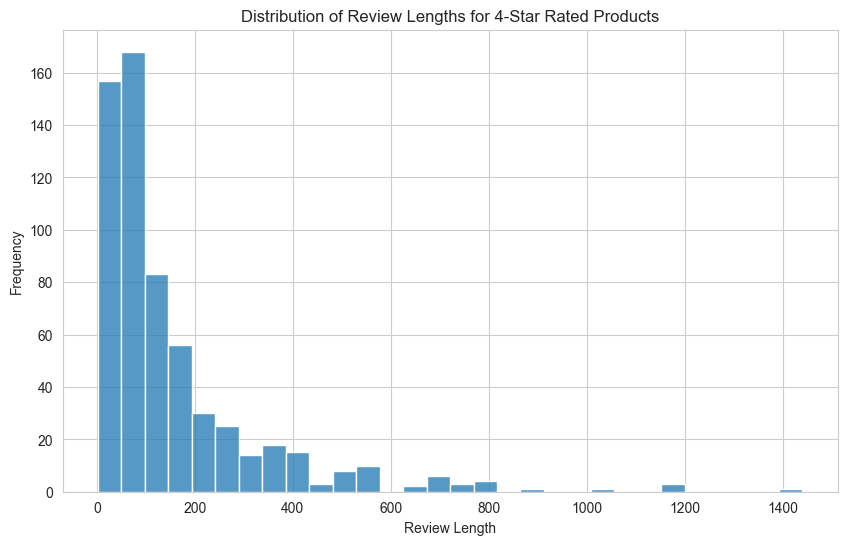

In [95]:
four_star_data = data[data['Rating'] == 4]

plt.figure(figsize=(10, 6))
sns.histplot(data=four_star_data, x='Length', bins=30)
plt.title('Distribution of Review Lengths for 4-Star Rated Products')
plt.xlabel('Review Length')
plt.ylabel('Frequency')
plt.show()


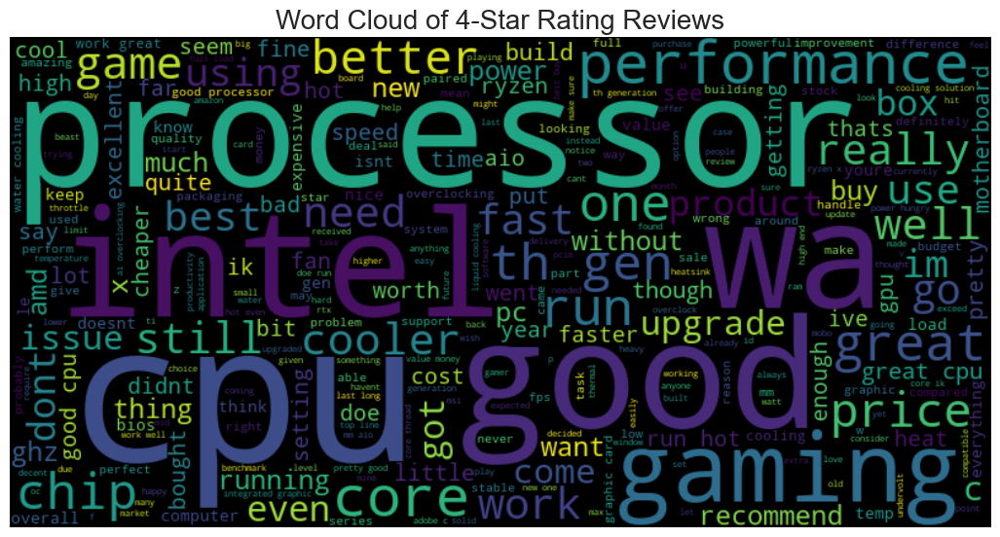

In [96]:
four_star_reviews = data[data['Rating'] == 4]['Review']
text = ' '.join(four_star_reviews)
wordcloud = WordCloud(width=800, height=400, max_words=300, background_color='black').generate(text)

plt.figure(figsize=(13, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud of 4-Star Rating Reviews', fontsize=20)
plt.axis('off')
plt.show()


Words can be seen in the above word cloud - great, best, fast, powerful etc
<br/>
Thus, there is an abundance of positive words in the wordcloud.

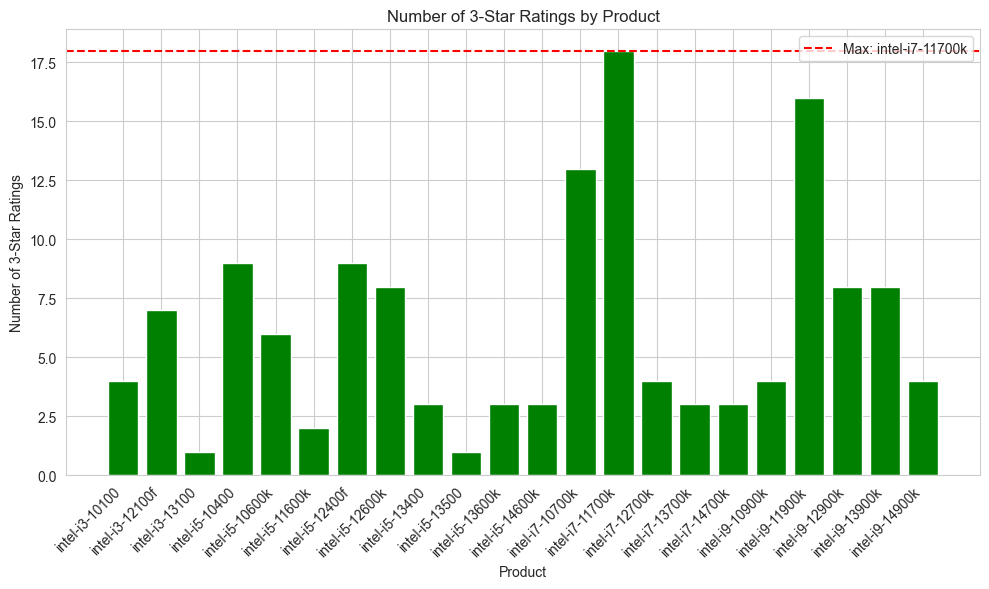

In [97]:

three_star_ratings = data[data['Rating'] == 3]

product_ratings_count = three_star_ratings.groupby('Product').size().reset_index(name='Number of 3-Star Ratings')

max_3_star_product = product_ratings_count.loc[product_ratings_count['Number of 3-Star Ratings'].idxmax()]

plt.figure(figsize=(10, 6))
plt.bar(product_ratings_count['Product'], product_ratings_count['Number of 3-Star Ratings'], color='green')
plt.title('Number of 3-Star Ratings by Product')
plt.xlabel('Product')
plt.ylabel('Number of 3-Star Ratings')
plt.xticks(rotation=45, ha='right')
plt.axhline(y=max_3_star_product['Number of 3-Star Ratings'], color='red', linestyle='--', label=f"Max: {max_3_star_product['Product']}")
plt.legend()
plt.tight_layout()
plt.show()


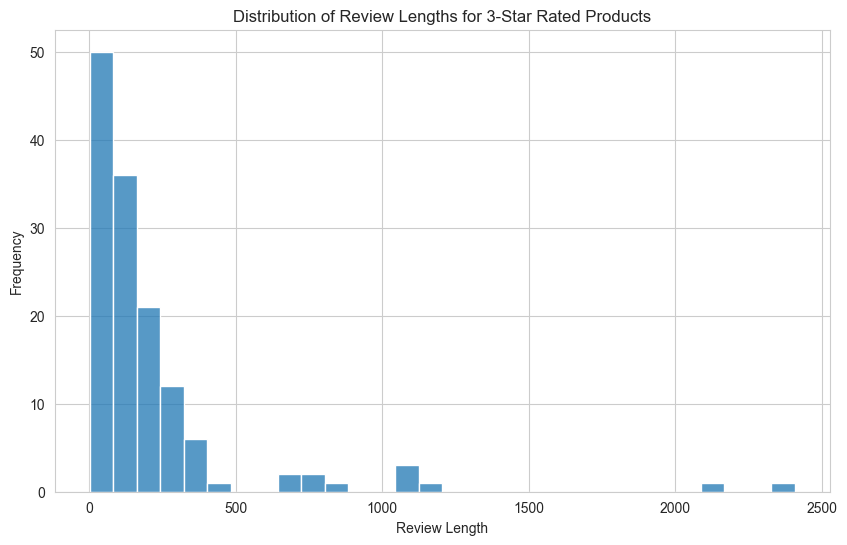

In [98]:
three_star_data = data[data['Rating'] == 3]

plt.figure(figsize=(10, 6))
sns.histplot(data=three_star_data, x='Length', bins=30)
plt.title('Distribution of Review Lengths for 3-Star Rated Products')
plt.xlabel('Review Length')
plt.ylabel('Frequency')
plt.show()


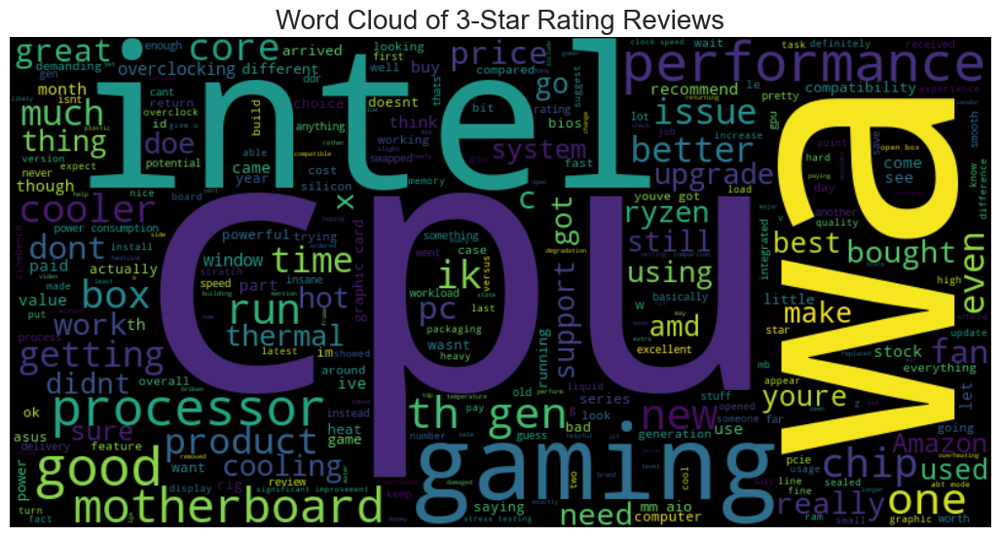

In [99]:
three_star_reviews = data[data['Rating'] == 3]['Review']
text = ' '.join(three_star_reviews)
wordcloud = WordCloud(width=800, height=400, max_words=300, background_color='black').generate(text)

plt.figure(figsize=(13, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud of 3-Star Rating Reviews', fontsize=20)
plt.axis('off')
plt.show()


Words can be seen in the above word cloud -  good, great, overclocking, cooler, hot etc <br/>
Thus, there are both negative and positive words in the above wordcloud.

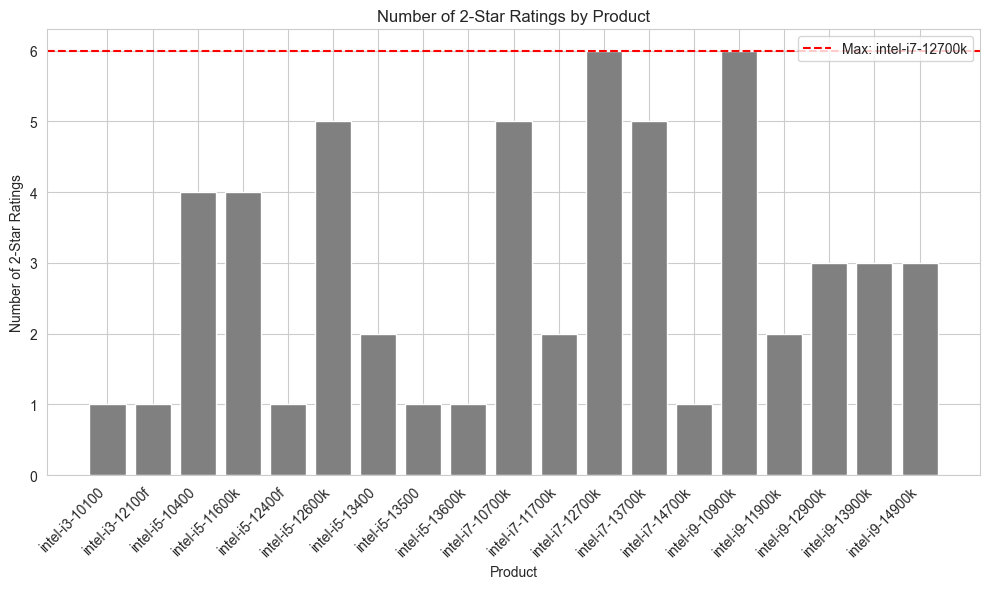

In [100]:

two_star_ratings = data[data['Rating'] == 2]

product_ratings_count = two_star_ratings.groupby('Product').size().reset_index(name='Number of 2-Star Ratings')

max_2_star_product = product_ratings_count.loc[product_ratings_count['Number of 2-Star Ratings'].idxmax()]

plt.figure(figsize=(10, 6))
plt.bar(product_ratings_count['Product'], product_ratings_count['Number of 2-Star Ratings'], color='grey')
plt.title('Number of 2-Star Ratings by Product')
plt.xlabel('Product')
plt.ylabel('Number of 2-Star Ratings')
plt.xticks(rotation=45, ha='right')
plt.axhline(y=max_2_star_product['Number of 2-Star Ratings'], color='red', linestyle='--', label=f"Max: {max_2_star_product['Product']}")
plt.legend()
plt.tight_layout()
plt.show()


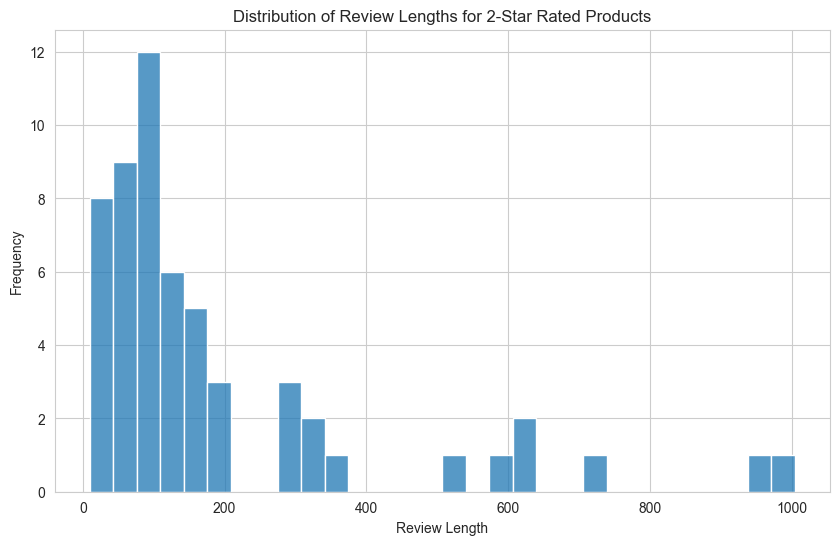

In [101]:
two_star_data = data[data['Rating'] == 2]

plt.figure(figsize=(10, 6))
sns.histplot(data=two_star_data, x='Length', bins=30)
plt.title('Distribution of Review Lengths for 2-Star Rated Products')
plt.xlabel('Review Length')
plt.ylabel('Frequency')
plt.show()


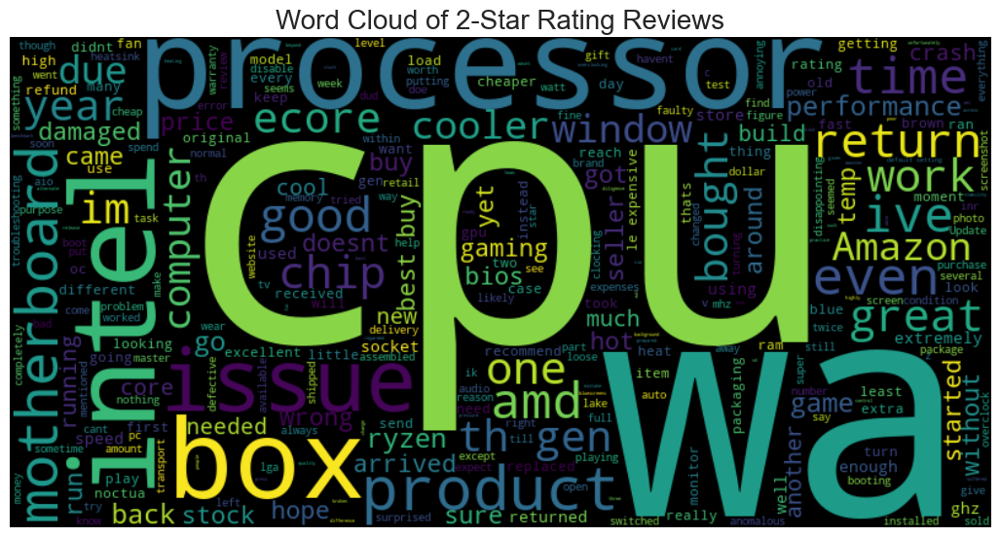

In [102]:
two_star_reviews = data[data['Rating'] == 2]['Review']
text = ' '.join(two_star_reviews)
wordcloud = WordCloud(width=800, height=400, max_words=300, background_color='black').generate(text)

plt.figure(figsize=(13, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud of 2-Star Rating Reviews', fontsize=20)
plt.axis('off')
plt.show()


Words can be seen in the above word cloud - great, damaged, crash, returned, expensive etc <br/>
Thus, there are some positive words but mostly they are negative.

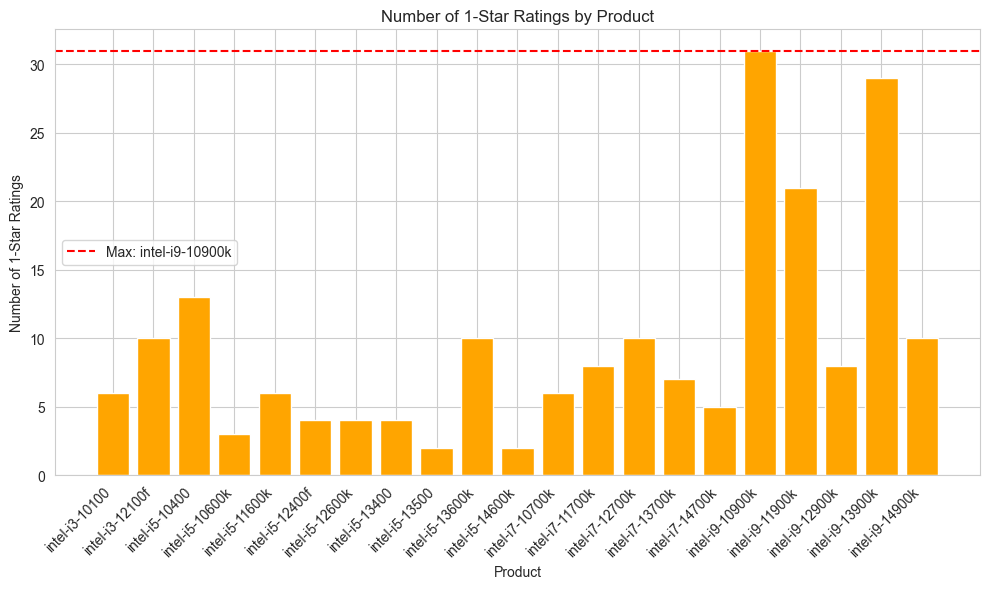

In [103]:

one_star_ratings = data[data['Rating'] == 1]

product_ratings_count = one_star_ratings.groupby('Product').size().reset_index(name='Number of 1-Star Ratings')

max_1_star_product = product_ratings_count.loc[product_ratings_count['Number of 1-Star Ratings'].idxmax()]

# Plot bar graph
plt.figure(figsize=(10, 6))
plt.bar(product_ratings_count['Product'], product_ratings_count['Number of 1-Star Ratings'], color='orange')
plt.title('Number of 1-Star Ratings by Product')
plt.xlabel('Product')
plt.ylabel('Number of 1-Star Ratings')
plt.xticks(rotation=45, ha='right')
plt.axhline(y=max_1_star_product['Number of 1-Star Ratings'], color='red', linestyle='--', label=f"Max: {max_1_star_product['Product']}")
plt.legend()
plt.tight_layout()
plt.show()


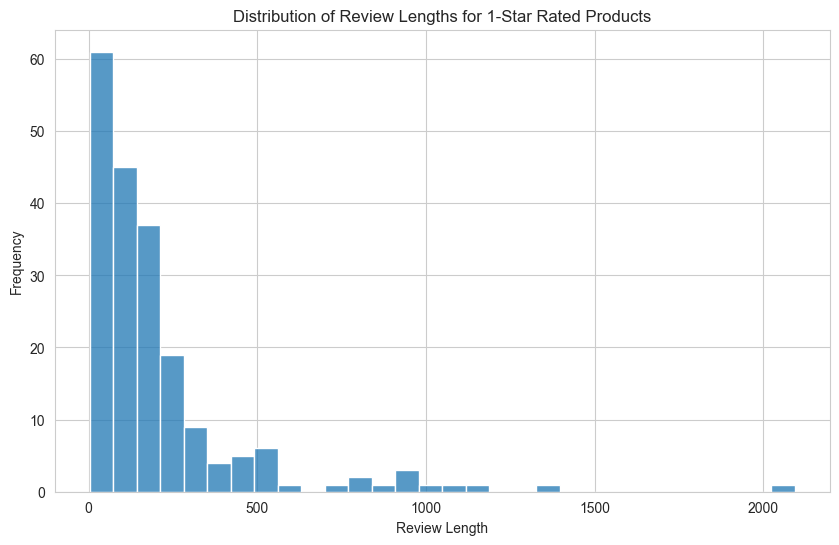

In [104]:
one_star_data = data[data['Rating'] == 1]

plt.figure(figsize=(10, 6))
sns.histplot(data=one_star_data, x='Length', bins=30)
plt.title('Distribution of Review Lengths for 1-Star Rated Products')
plt.xlabel('Review Length')
plt.ylabel('Frequency')
plt.show()


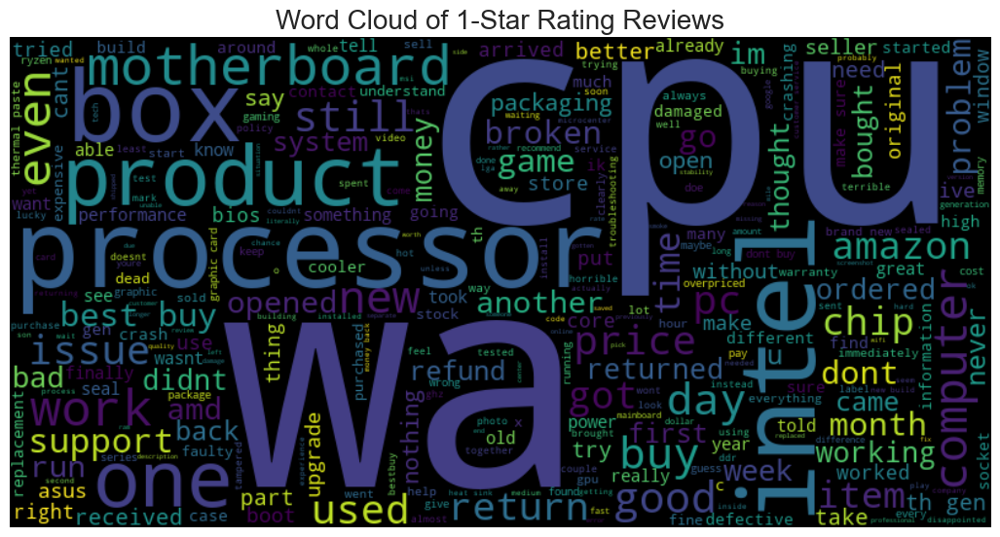

In [105]:
one_star_reviews = data[data['Rating'] == 1]['Review']
text = ' '.join(one_star_reviews)
wordcloud = WordCloud(width=800, height=400, max_words=300, background_color='black').generate(text)

plt.figure(figsize=(13, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud of 1-Star Rating Reviews', fontsize=20)
plt.axis('off')
plt.show()


Words can be seen in the above word cloud - problem, return, replacement, bad, defective, broken, damaged etc <br/>
There are mostly negative words in the above word cloud.

<a id="section-9"></a>
<div style="padding: 30px; color:white; margin:10;  text-align:left; display:fill; border-radius:10px; background-color:#3b3745">
    <b><span style='color:#F1A424; font-size: 160%;'> 7 |</span></b> <b style="font-size: 160%;">  Analyzing 'Product' column </b>
    <p style="margin-top: 5px; font-size: 100%;">This column refers to the variation or type of processor. Example - intel-i7-14700k, intel-i9-14900k etc.
</p>
</div>


The various different products present in the dataset are as follows,

In [106]:
print(f"Variation value count: \n{data['Product'].value_counts()}")

Variation value count: 
Product
intel-i7-10700k    757
intel-i7-12700k    625
intel-i9-13900k    615
intel-i7-13700k    597
intel-i9-12900k    544
intel-i7-11700k    514
intel-i9-10900k    504
intel-i5-12600k    482
intel-i5-13600k    359
intel-i9-11900k    320
intel-i5-12400f    318
intel-i9-14900k    299
intel-i5-10400     277
intel-i3-12100f    247
intel-i7-14700k    223
intel-i5-11600k    197
intel-i3-10100     164
intel-i5-10600k    153
intel-i5-14600k    122
intel-i5-13500      74
intel-i5-13400      73
intel-i3-13100      64
Name: count, dtype: int64


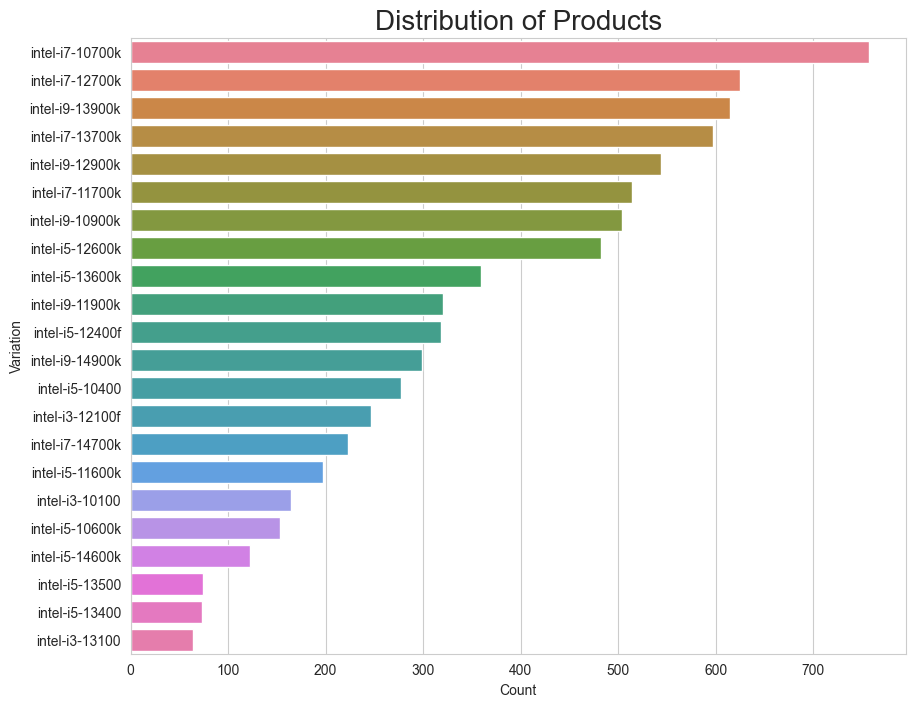

In [107]:
variation_counts = data['Product'].value_counts()

variation_counts_df = pd.DataFrame({'Variation': variation_counts.index, 'Count': variation_counts.values})

plt.figure(figsize=(10, 8))
sns.barplot(data=variation_counts_df, x='Count', y='Variation', hue='Variation', dodge=False, legend=False)
plt.title('Distribution of Products', fontsize= 20)
plt.xlabel('Count')
plt.ylabel('Variation')
plt.show()


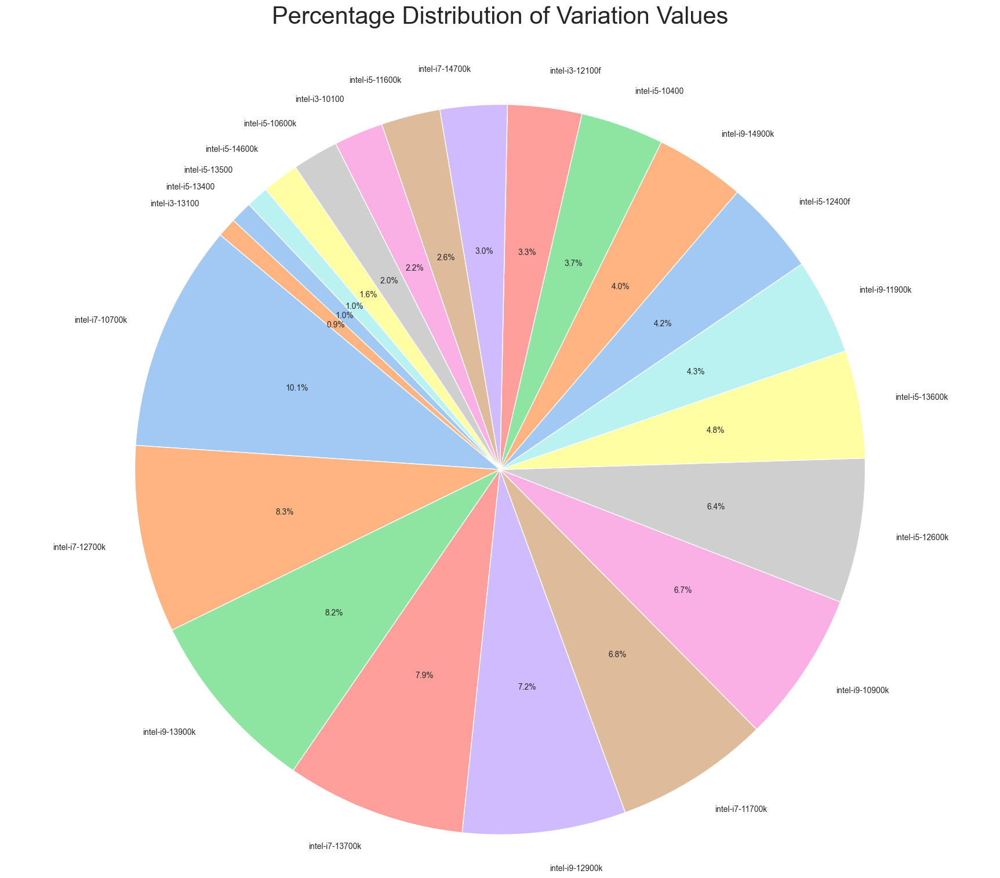

In [108]:
variation_counts = data['Product'].value_counts()

percentage_distribution = variation_counts / variation_counts.sum() * 100

colors = sns.color_palette('pastel')

plt.figure(figsize=(22, 18))
plt.pie(percentage_distribution, labels=percentage_distribution.index, autopct='%1.1f%%', startangle=140, colors=colors)
plt.title('Percentage Distribution of Variation Values', fontsize=30, y=1.05)  
plt.axis('equal')  

for label in plt.gca().get_xticklabels() + plt.gca().get_yticklabels():
    label.set_fontsize(30)

plt.show()


Mean rating according to variation

Computing the mean rating for each product in the dataset.





In [109]:
data.groupby('Product')['Rating'].mean()

Product
intel-i3-10100     4.731707
intel-i3-12100f    4.643725
intel-i3-13100     4.921875
intel-i5-10400     4.595668
intel-i5-10600k    4.771242
intel-i5-11600k    4.670051
intel-i5-12400f    4.789308
intel-i5-12600k    4.854772
intel-i5-13400     4.561644
intel-i5-13500     4.756757
intel-i5-13600k    4.816156
intel-i5-14600k    4.721311
intel-i7-10700k    4.834875
intel-i7-11700k    4.749027
intel-i7-12700k    4.817600
intel-i7-13700k    4.847571
intel-i7-14700k    4.744395
intel-i9-10900k    4.646825
intel-i9-11900k    4.512500
intel-i9-12900k    4.829044
intel-i9-13900k    4.720325
intel-i9-14900k    4.682274
Name: Rating, dtype: float64

Let's analyze the above ratings in the form of a bar plot

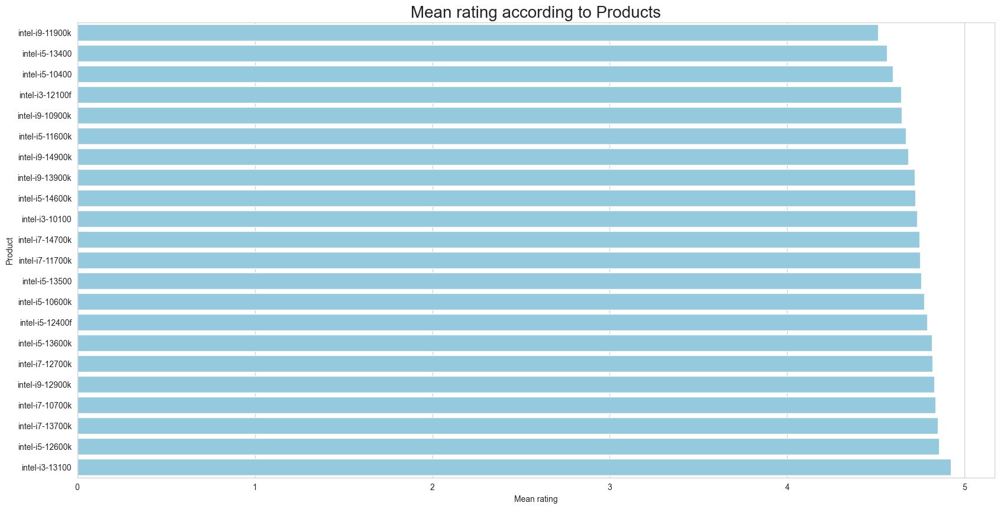

In [110]:
mean_ratings = data.groupby('Product')['Rating'].mean().sort_values()

plt.figure(figsize=(20,10))

sns.barplot(x=mean_ratings.values, y=mean_ratings.index, color='skyblue')

plt.title("Mean rating according to Products", fontsize=20)
plt.xlabel('Mean rating')
plt.ylabel('Product')

plt.show()


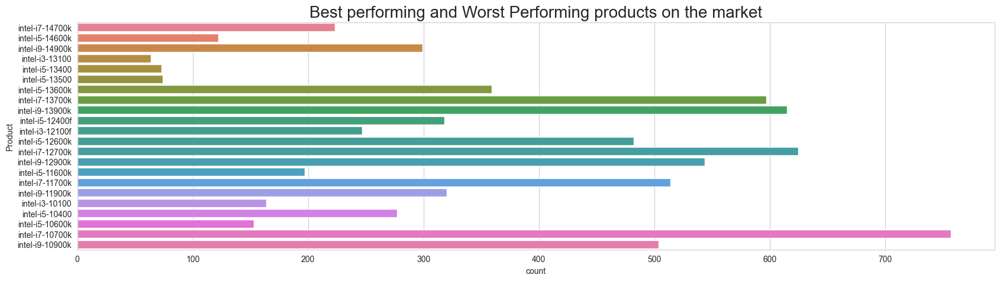

In [111]:
fig = plt.figure(figsize=(20, 5))  
sns.countplot(y='Product', data=data, hue='Product', legend=False)
plt.title('Best performing and Worst Performing products on the market', fontsize=20)
plt.show()


The above graph shows the Best and the Worst performing products on the market

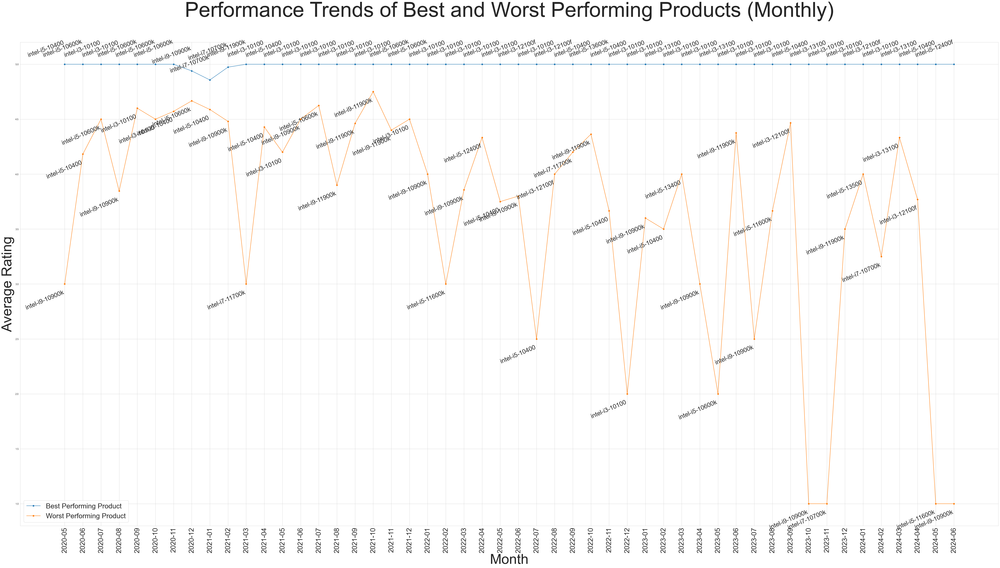

In [112]:
data['Date'] = pd.to_datetime(data['Date'])

data['Month'] = data['Date'].dt.to_period('M').astype(str)

monthly_performance = data.groupby(['Product', 'Month']).agg({'Rating': 'mean'}).reset_index()

best_performing = monthly_performance.loc[monthly_performance.groupby('Month')['Rating'].idxmax()]

worst_performing = monthly_performance.loc[monthly_performance.groupby('Month')['Rating'].idxmin()]

plt.figure(figsize=(60, 34))  
plt.plot(best_performing['Month'], best_performing['Rating'], label='Best Performing Product', marker='o')
plt.plot(worst_performing['Month'], worst_performing['Rating'], label='Worst Performing Product', marker='o')
plt.title('Performance Trends of Best and Worst Performing Products (Monthly)', fontsize=90, y=1.05)  # Increase font size and add spacing
plt.xlabel('Month', fontsize=60)  
plt.ylabel('Average Rating', fontsize=60) 
plt.xticks(rotation=90, fontsize=30) 
plt.legend(fontsize=30)  

for i, row in best_performing.iterrows():
    plt.text(row['Month'], row['Rating'] + 0.05, f" {row['Product']}", fontsize=27, ha='right', va='bottom', rotation=20)
for i, row in worst_performing.iterrows():
    plt.text(row['Month'], row['Rating'] - 0.05, f" {row['Product']}", fontsize=27, ha='right', va='top', rotation=23)

plt.grid(True)
plt.tight_layout()
plt.show()


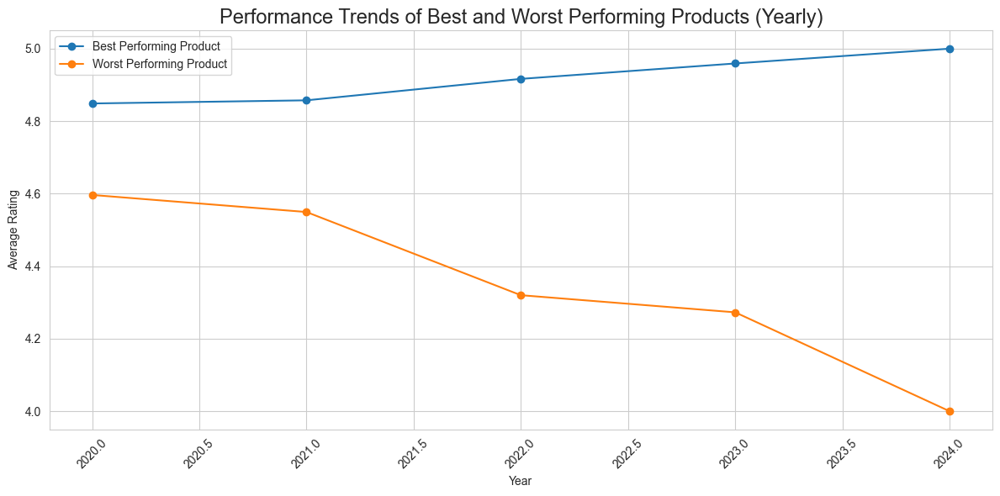

In [113]:
data['Date'] = pd.to_datetime(data['Date'])

data['Year'] = data['Date'].dt.year

yearly_performance = data.groupby(['Product', 'Year']).agg({'Rating': 'mean'}).reset_index()

best_performing_yearly = yearly_performance.loc[yearly_performance.groupby('Year')['Rating'].idxmax()]

worst_performing_yearly = yearly_performance.loc[yearly_performance.groupby('Year')['Rating'].idxmin()]

plt.figure(figsize=(12, 6))
plt.plot(best_performing_yearly['Year'], best_performing_yearly['Rating'], label='Best Performing Product', marker='o')
plt.plot(worst_performing_yearly['Year'], worst_performing_yearly['Rating'], label='Worst Performing Product', marker='o')
plt.title('Performance Trends of Best and Worst Performing Products (Yearly)', fontsize= 17)
plt.xlabel('Year')
plt.ylabel('Average Rating')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


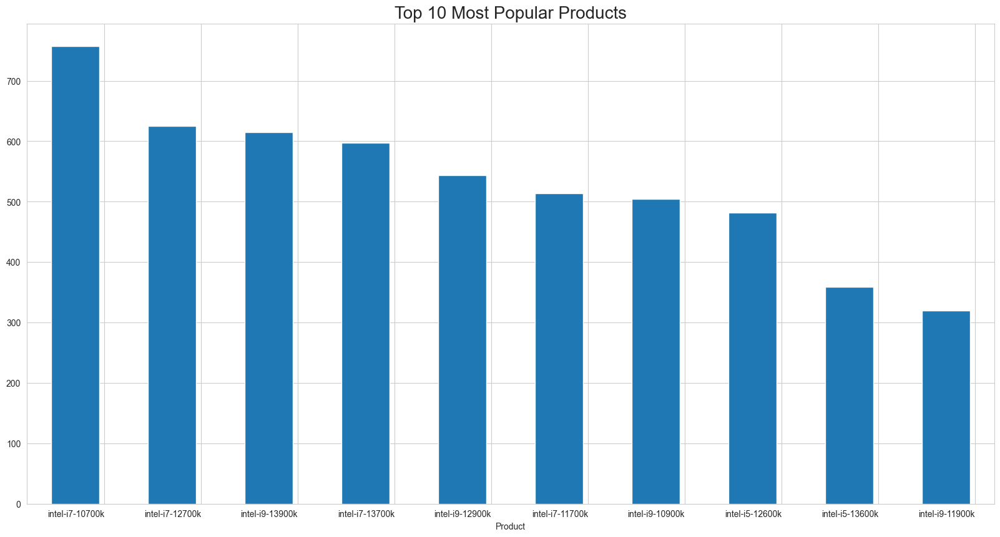

In [114]:
plt.figure(figsize=(20, 10))
top_products = data['Product'].value_counts().nlargest(10)
top_products.plot(kind='bar')

plt.title('Top 10 Most Popular Products', fontsize=20)
plt.xticks(np.arange(len(top_products)) + 0.3, top_products.index, rotation=0, ha='right')  
plt.show()


The above graph shows gives a brief informatiion about the 10 most popular products. 

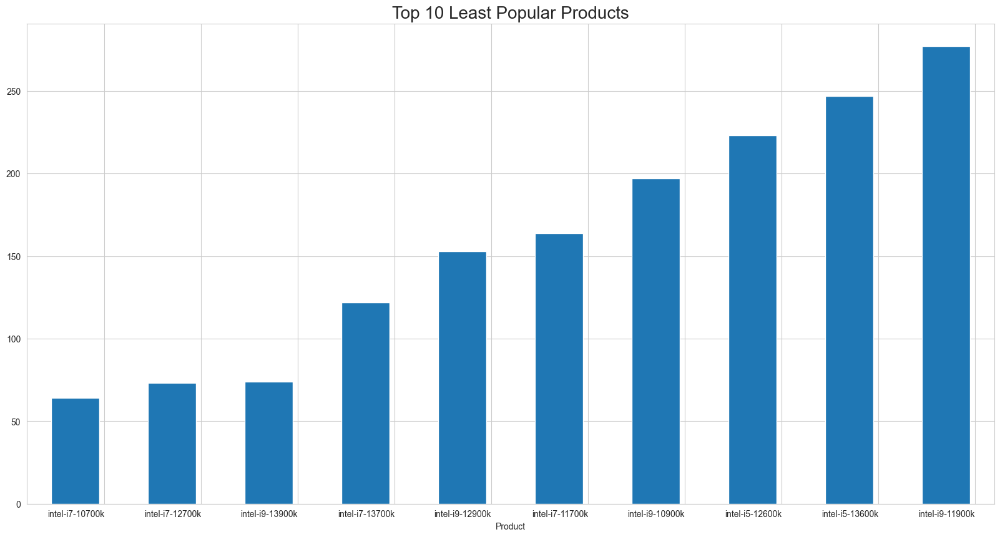

In [115]:
plt.figure(figsize=(20,10))
data['Product'].value_counts().nsmallest(10).plot(kind='bar')
plt.title('Top 10 Least Popular Products', fontsize=20)
plt.xticks(np.arange(len(top_products)) + 0.3, top_products.index, rotation=0, ha='right')  
plt.show()


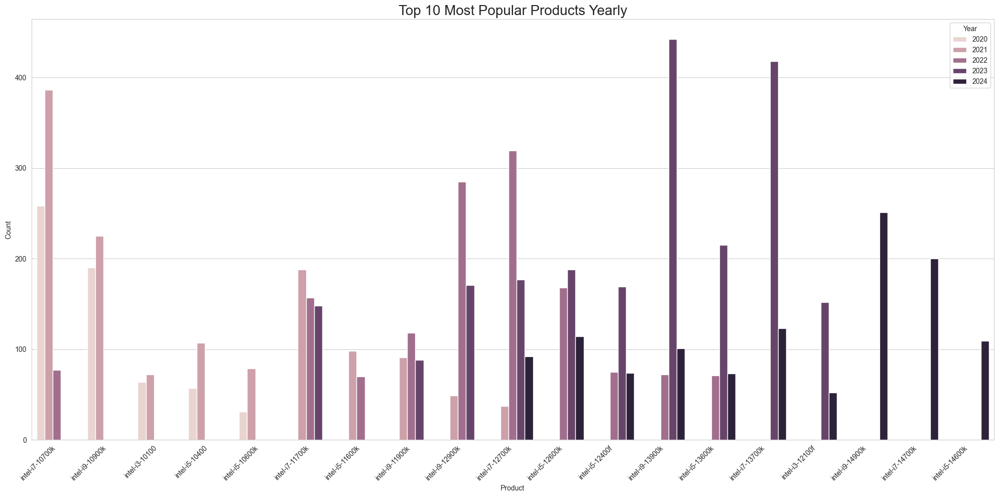

In [116]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

data['Year'] = data['Date'].dt.year

yearly_top_products = data.groupby(['Year', 'Product']).size().reset_index(name='Count')

top_products_yearly = (
    yearly_top_products
    .groupby('Year', as_index=False)  
    .apply(lambda x: x.nlargest(10, 'Count'))
    .reset_index(drop=True)
)

plt.figure(figsize=(20, 10))
sns.barplot(data=top_products_yearly, x='Product', y='Count', hue='Year')
plt.title('Top 10 Most Popular Products Yearly', fontsize=20)
plt.xlabel('Product')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Year')
plt.tight_layout()
plt.show()


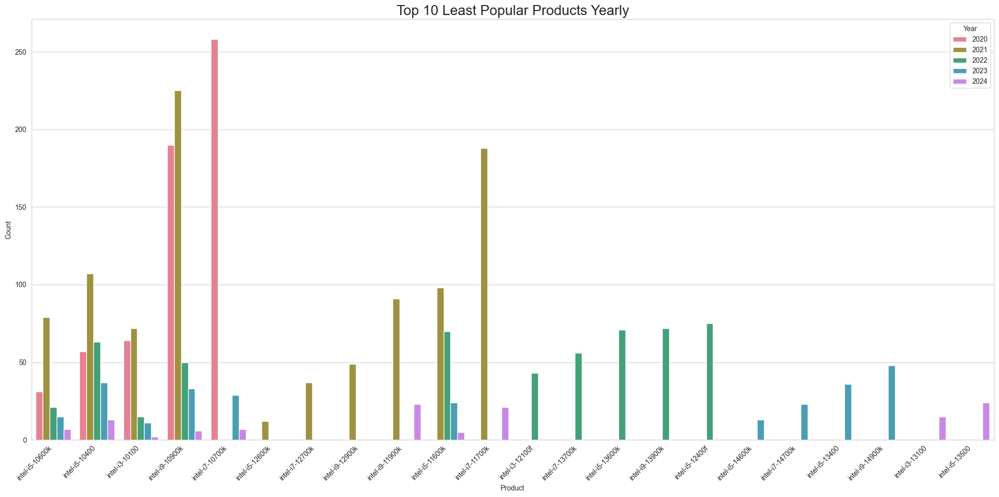

In [118]:
yearly_bottom_products = data.groupby(['Year', 'Product']).size().reset_index(name='Count')

bottom_products_yearly = (
    yearly_bottom_products
    .groupby('Year', as_index=False)  
    .apply(lambda x: x.nsmallest(10, 'Count'))
    .reset_index(drop=True)
)

custom_palette = sns.color_palette("husl", n_colors=len(bottom_products_yearly['Year'].unique()))


plt.figure(figsize=(20, 10))
sns.barplot(data=bottom_products_yearly, x='Product', y='Count', hue='Year', palette=custom_palette)
plt.title('Top 10 Least Popular Products Yearly', fontsize=20)
plt.xlabel('Product')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Year')
plt.tight_layout()
plt.show()


<a id="section-10"></a>
<div style="padding: 30px; color:white; margin:10;  text-align:left; display:fill; border-radius:10px; background-color:#3b3745">
    <b><span style='color:#F1A424; font-size: 160%;'> 8 |</span></b> <b style="font-size: 160%;">  Analyzing 'Review' column </b>
    <p style="margin-top: 5px; font-size: 100%;">This column contains the textual review given by the user for a variation for the product.</p>
</div>


In [728]:
data['Length'].describe()

count    7528.000000
mean      140.776435
std       229.125389
min         1.000000
25%        44.000000
50%        73.000000
75%       149.000000
max      5345.000000
Name: Length, dtype: float64

Length analysis for full dataset

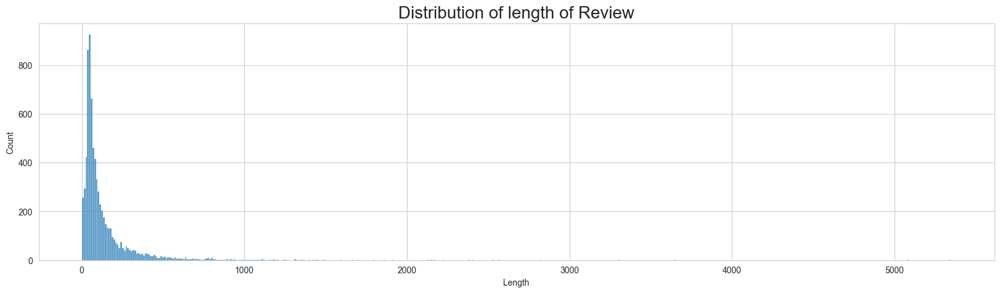

In [729]:
plt.figure(figsize=(20,5))
sns.histplot(data['Length'])
plt.title('Distribution of length of Review', fontsize=20)
plt.show()


Length analysis when Rating is 5 (positive)

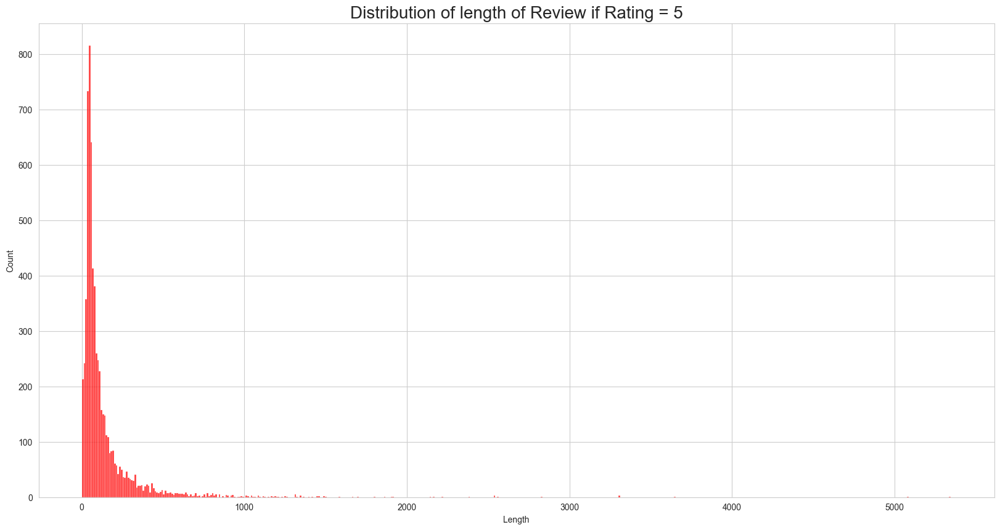

In [730]:
plt.figure(figsize=(20,10))
sns.histplot(data[data['Rating'] == 5]['Length'], color='red')
plt.title('Distribution of length of Review if Rating = 5', fontsize=20)
plt.show()


Length analysis when Rating is 4, 3, 2 or 1 (negative)

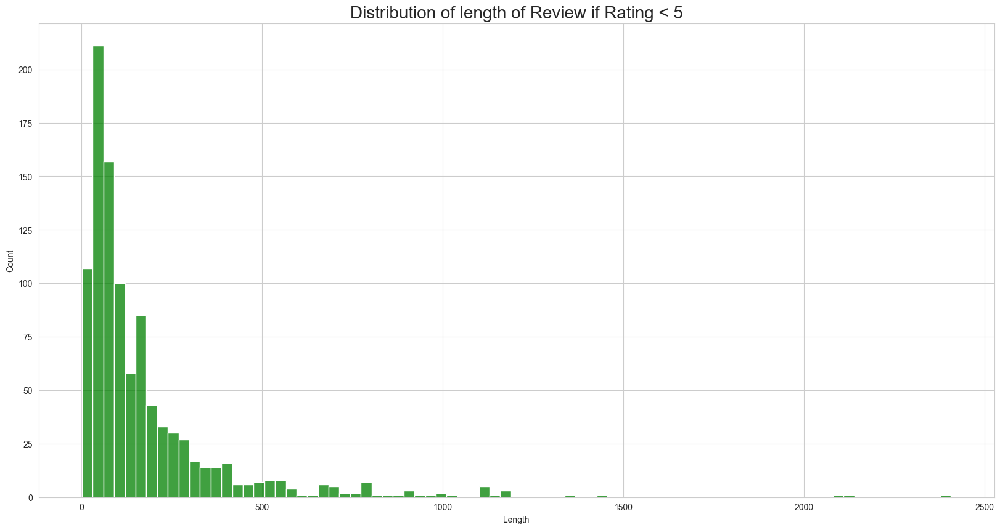

In [731]:
filtered_data = data[(data['Rating'] == 4) | (data['Rating'] == 3) | (data['Rating'] == 2) | (data['Rating'] == 1)]['Length']
plt.figure(figsize=(20,10))
sns.histplot(filtered_data, color='green')
plt.title('Distribution of length of Review if Rating < 5', fontsize=20)
plt.show()


Lengthwise mean rating

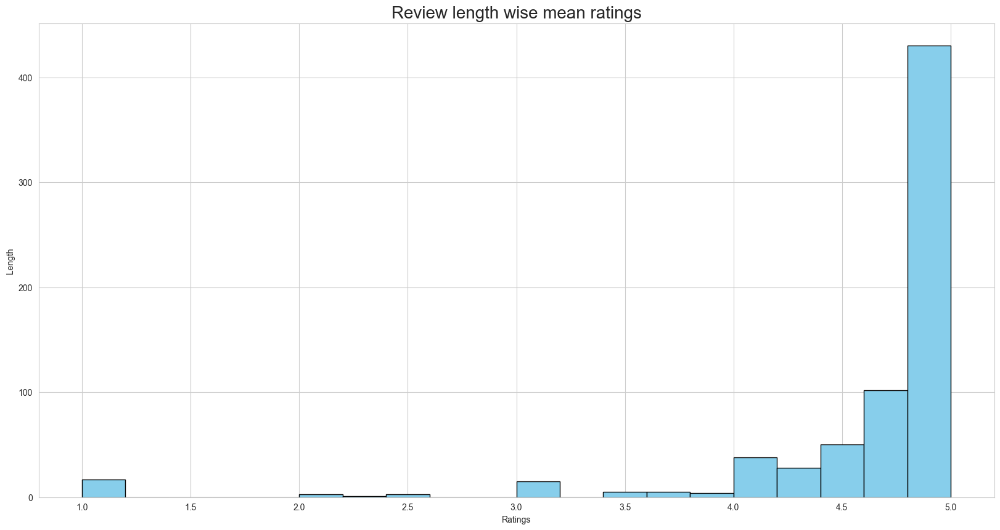

In [732]:
plt.figure(figsize=(20,10))
data.groupby('Length')['Rating'].mean().plot.hist(color='skyblue', bins=20, edgecolor='black')
plt.title("Review length wise mean ratings", fontsize= 20)
plt.xlabel('Ratings')
plt.ylabel('Length')
plt.show()


In [737]:
cv = CountVectorizer(stop_words='english')
words = cv.fit_transform(data.Review)

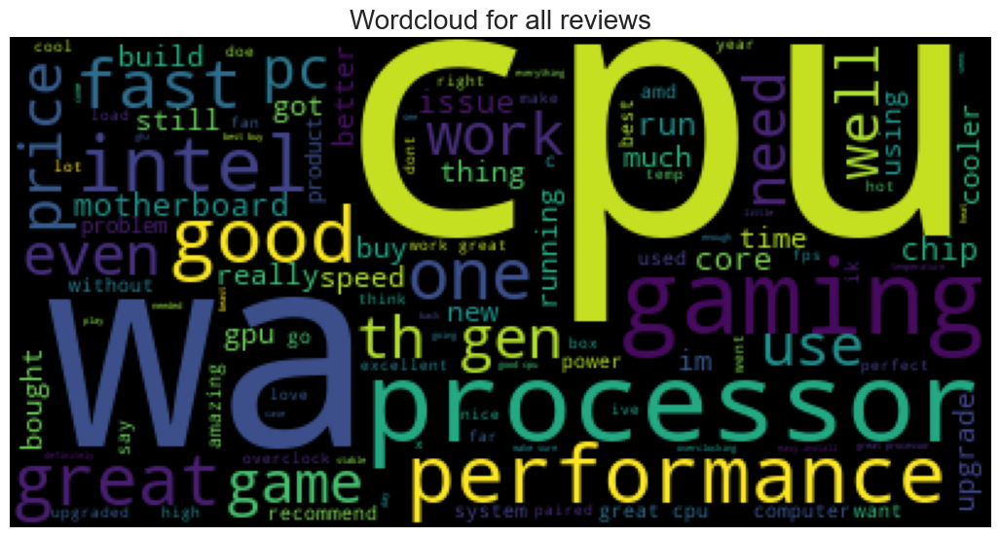

In [738]:
reviews = " ".join([review for review in data['Review']])
                        
wc = WordCloud(background_color='black', max_words=110)

plt.figure(figsize=(13,10))
plt.imshow(wc.generate(reviews))
plt.title('Wordcloud for all reviews', fontsize=20)
plt.axis('off')
plt.show()

Lets find the unique words in each feedback category

In [742]:
neg_reviews = " ".join([review for review in data[(data['Rating'] == 4) | (data['Rating'] == 3) | (data['Rating'] == 2) | (data['Rating'] == 1)]['Review']])

neg_reviews = neg_reviews.lower().split()

pos_reviews = " ".join([review for review in data[(data['Rating'] == 5)  ]['Review']])
pos_reviews = pos_reviews.lower().split()

unique_negative = [x for x in neg_reviews if x not in pos_reviews]
unique_negative = " ".join(unique_negative)

unique_positive = [x for x in pos_reviews if x not in neg_reviews]
unique_positive = " ".join(unique_positive)


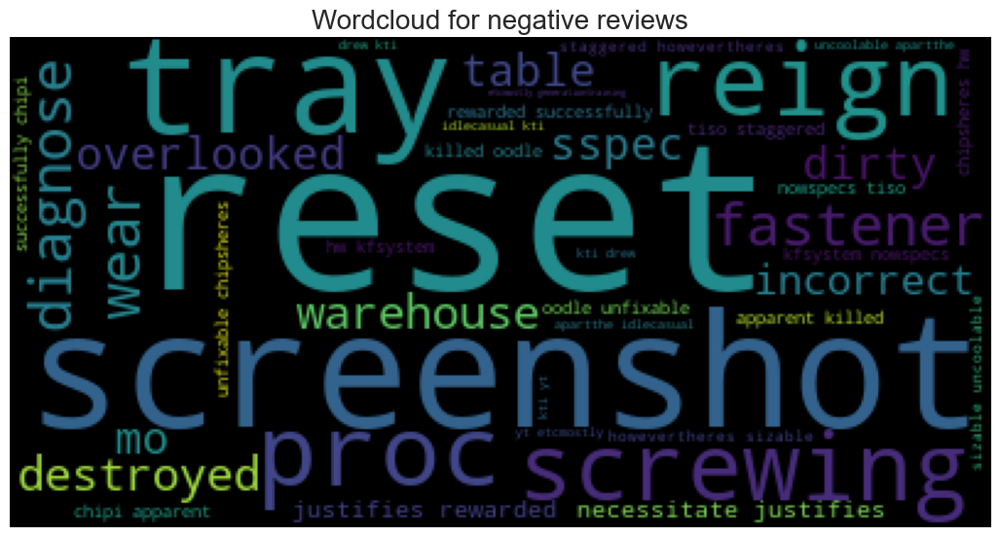

In [740]:
wc = WordCloud(background_color='black', max_words=500)

plt.figure(figsize=(13,10))
plt.imshow(wc.generate(unique_negative))
plt.title('Wordcloud for negative reviews', fontsize=20)
plt.axis('off')
plt.show()

Negative words can be seen in the above word cloud - degradation, mediocre, killed, unfixable, reset, guter etc

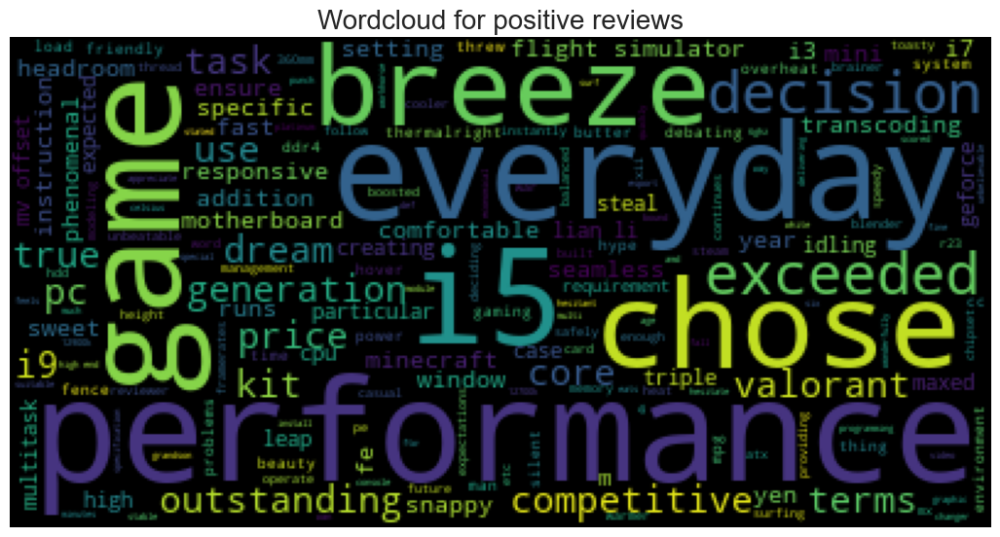

In [741]:
wc = WordCloud(background_color='black', max_words=300)

plt.figure(figsize=(13,10))
plt.imshow(wc.generate(unique_positive))
plt.title('Wordcloud for positive reviews', fontsize=20)
plt.axis('off')
plt.show()

Positive words can be seen in the above word cloud - outstanding, perfecto, phenomenal, dream,seamless, sweet, beauty  etc

                                   This concludes the analysis presented in this notebook.
